# 3. Analysis

## Table of contents

- 1 [Creating Networks](#CN)
- 2 [Fan Network](#FN)
    - 2.1 [Fan Network Statistics](#FNS)
    - 2.2 [Communities](#FNC)
    - 2.3 [Descriptions](#FND)
    - 2.4 [Tags](#FNT)
    - 2.5 [Reviews](#FNR)
    - 2.6 [Languages](#FNL)
- 3 [Hater Network](#HN)    
    - 3.1 [Hater Network Statistics](#HNS)
    - 3.2 [Communities](#HNC)
    - 3.3 [Descriptions](#HND)
    - 3.4 [Tags](#HNT)
    - 3.5 [Reviews](#HNR)
    - 3.6 [Languages](#HNL)
- 4 [Fans vs Haters](#FVH)
    - 4.1 [Positive Reviews](#FVHPR)
    - 4.2 [Negative Reviews](#FVHNR)
    - 4.3 [Languages](#FVHL)


In [2]:
#IMPORTS
from sklearn.model_selection import train_test_split
import pandas as pd
import io
import re
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
import nltk, pprint
from nltk import word_tokenize
import community
from collections import defaultdict
import pickle
from networkx.algorithms import bipartite
import operator
from langdetect import detect
from wordcloud import WordCloud
import operator
import math
import collections
import itertools
from fa2 import ForceAtlas2

<a id="CN"></a>

# Creating networks

We are going to analyse books network, by making **Fans and Haters networks** and look into their communities to see what they have in common.

For creating our fans networks, we first made a bipartite graph for 3000 most popular book.  In this graph, books were connected to users who rated this books 4 or 5. Then, we projected this graph on books. In resulting graphs, books are nodes and they are connected if the same person rated them high. The weights of edges indicate the number of people who rated the books high.
For the haters graph, the same procedure is done for the same books but for the rating 1 and 2.

The networks are created by **networkx**  library. Also, for finding the position of the nodes **forceatlas2** is used.


## Bipartite Graphs

In [2]:
#loading rates
rating = pd.read_csv('/home/elika/uni/network/project/ratings.csv',encoding='utf-8')

In [4]:
# Sorting books according to their ratings
sorted_rating = rating.copy(deep=True)
sorted_rating = sorted_rating.groupby(['book_id']).sum().sort_values(by ='rating', ascending = False).reset_index()

In [5]:
# select the 3000 most popular books
new_rating = sorted_rating[0:3000] 

#finding the book ids of chosen books
new_book_ids = new_rating['book_id'].tolist()

# finding the rating of the chosen books
books_rating = rating.loc[rating['book_id'].isin(new_book_ids)]

<a id="FN"></a>

# Fan network

1. **Nodes**: 3k most popular book + users who liked the books
2. **Edges**: Users is connected to the books they liked

In [7]:
#selecting only ratings > 3
high_ratings = books_rating.loc[books_rating['rating']>3]

In [58]:
#create bipartite network - runs 5-10min
bipartite = nx.Graph()
book_nodes = set()
user_nodes = set()


for index, row in high_ratings.iterrows():
    b = high_ratings.at[index,'book_id']
    u = high_ratings.at[index,'user_id']
    
    # book ids and user ids can be the same! - name books and user nodes using different prefix 
    book = "B"+str(b)
    user = "U"+str(u)
    
    bipartite.add_edge(book,user)
    book_nodes.add(book)
    user_nodes.add(user)

In [9]:
print("Number of nodes: "+ str(bipartite.number_of_nodes()))

print('Number of edges: ' + str(bipartite.number_of_edges()))

Number of nodes: 37720
Number of edges: 235653


In [15]:
forceatlas2 = ForceAtlas2(
                        # Behavior alternatives
                        outboundAttractionDistribution=False,  # Dissuade hubs
                        linLogMode=False,  # NOT IMPLEMENTED
                        adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
                        edgeWeightInfluence=1.0,

                        # Performance
                        jitterTolerance=1.0,  # Tolerance
                        barnesHutOptimize=False,
                        barnesHutTheta=1.2,
                        multiThreaded=False,  # NOT IMPLEMENTED

                        # Tuning
                        scalingRatio=1.0,
                        strongGravityMode=False,
                        gravity=60.0, #1.0,

                        # Log
                        verbose=False)
positions1 = forceatlas2.forceatlas2_networkx_layout(bipartite, pos=None, iterations=2000)
    

In [16]:
# #storing positions for bipartie graph
# with open('EN_P_for_biparite.pkl', 'wb') as f:
#     pickle.dump(positions1, f)

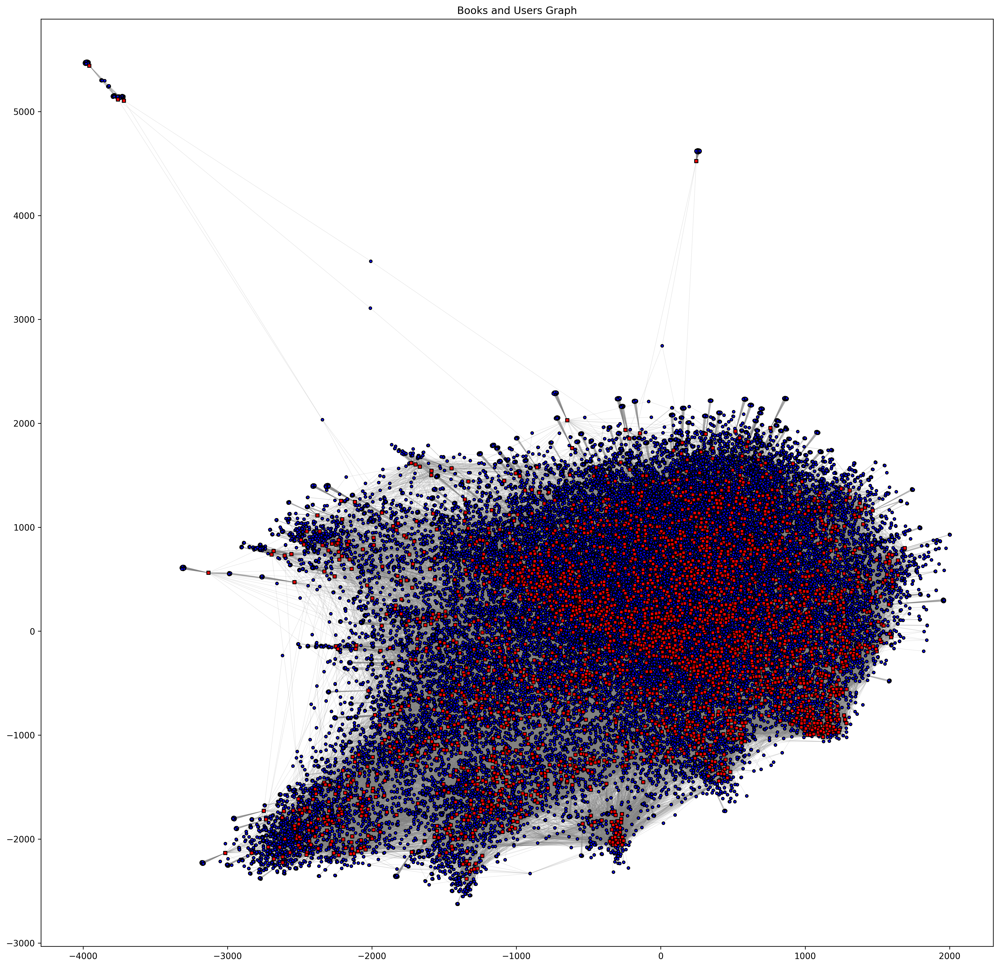

In [17]:
plt.figure(num=None, figsize=(20, 20), dpi=300, facecolor='w', edgecolor='k')

nx.draw_networkx_nodes(bipartite, positions1, with_labels=False, nodelist=user_nodes, node_color="blue", edgecolors="black", node_size = 10 ,node_shape="o")
nx.draw_networkx_nodes(bipartite, positions1, with_labels=False, nodelist=book_nodes, node_color="red", edgecolors="black", node_size = 15,node_shape="s" )


nx.draw_networkx_edges(bipartite, positions1, alpha=0.2, edge_color="gray", width=0.5, edgelist=bipartite.edges())



plt.title("Books and Users Graph")
plt.show()

### Projected graph

In [59]:
#projecting the bipartite graph on books
new_G = nx.bipartite.weighted_projected_graph(bipartite.to_undirected(), book_nodes, ratio=False)

In [20]:
# with open('positions_for_2rating_projeted.pkl', 'rb') as f:
#      positions = pickle.load(f)

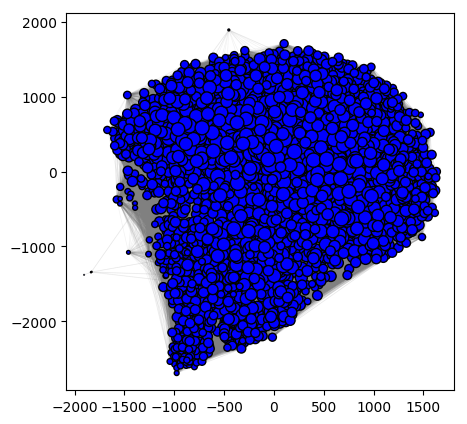

In [42]:
#the forceatlas is used in order to find the position, the code is removed to make notebook shorter

#making node size list proportional to the degree of nodes
node_size = list(dict(new_G.degree()).values())
node_size = [float(size)/10 for size in node_size]

#ploting the network
plt.figure(num=None, figsize=(5, 5), dpi=100, facecolor='w', edgecolor='k')

nx.draw_networkx_nodes(new_G, positions, with_labels=True, nodelist=list(new_G.nodes()), node_color="blue", edgecolors="black", node_size = node_size) 
nx.draw_networkx_edges(new_G, positions, alpha=0.1, edge_color="gray", width=0.5, edgelist=new_G.edges())

plt.show()

In [22]:
#number of nodes
print('number of nodes: ' + str(new_G.number_of_nodes()))

#number of edges
print('number of edges: ' + str(new_G.number_of_edges()))

number of nodes: 3000
number of edges: 955177


<a id="FNS"></a>

## Fan network statistics

For gaining a better insight of the fans graph, weight distribution, degree distribution and sum of the weights that are connected to a node distribution is plotted below


#### Degree Distribution
Plot degree distribution with both linear and log-log axes.

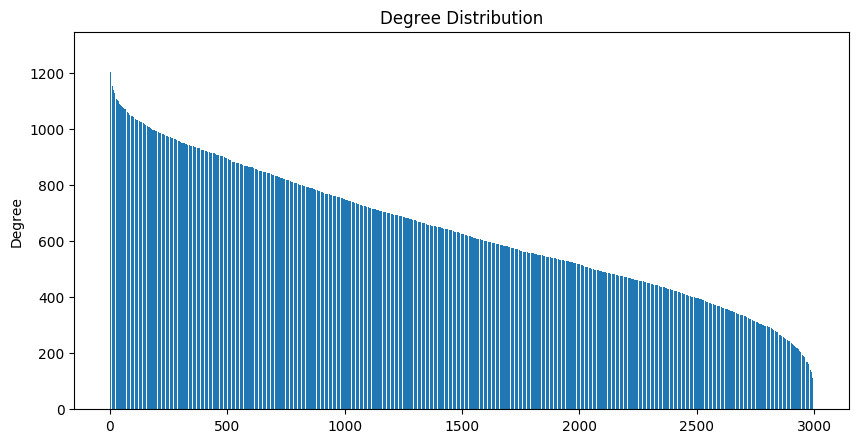

In [44]:
#sorting the degree distribution
degree_dis = list(dict(new_G.degree()).values())
sorted_degree_dis = sorted(degree_dis, reverse=True)

#ploting the degree Distribution
plt.figure(figsize=(10, 5), dpi= 100)
plt.bar(range(len(sorted_degree_dis)),sorted_degree_dis, align='center')
plt.title('Degree Distribution')
plt.ylabel('Degree')
plt.show()

Text(0.5,1,'Degree Distribution')

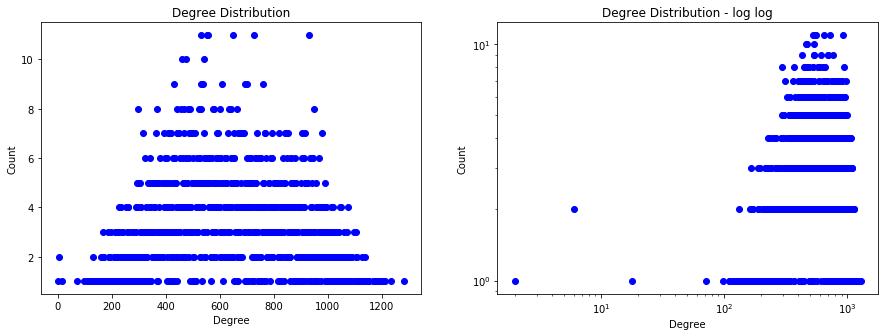

In [26]:
#create bins
bin1 = sorted(list(set(degree_dis)))

#count frequencies
import collections
counter=collections.Counter(degree_dis)
counter = sorted(counter.items())
#split in the list of degrees and counts
x, y = zip(*counter)

fig, axes = plt.subplots(nrows=1, ncols=2,figsize=(15,5))
ax1, ax0 = axes.flatten()

ax0.scatter(x,y, c='blue')
ax0.set_yscale('log')
ax0.set_xscale('log')
ax0.set(ylabel='Count')
ax0.set(xlabel='Degree')
ax0.set_title('Degree Distribution - log log')

ax1.scatter(x,y, c='blue')
ax1.set(ylabel='Count')
ax1.set(xlabel='Degree')
ax1.set_title('Degree Distribution')

In [24]:
print('Minimum degree in network: '+ str(min(degree_dis)))
print('Maximum degree in network:' + str(max(degree_dis)))
print('Mean degree in network: '+ str(np.mean(degree_dis)))

Minimum degree in network: 2
Maximum degree in network:1283
Mean degree in network: 636.7846666666667


#### Weight distribution (for nodes)
The sum of weights on the connected edges for each node is calculated and rhe distribution is shown below.

In [28]:
#ploting weight distribution for nodes(sum the weights on edges connected to node)

#making an empty dictionory to fill with weights
node_weight = dict((key, value) for (key, value) in zip(list(new_G.nodes()),[0]*3000)) #

weights = dict(nx.get_edge_attributes(new_G, 'weight'))
#for each node sum the weights of connected edges
for key,values in weights.items():
    node_weight[key[0]] += values
    node_weight[key[1]] += values

weight_dis = list(node_weight.values())
sorted_weight_dis = sorted(weight_dis, reverse=True)

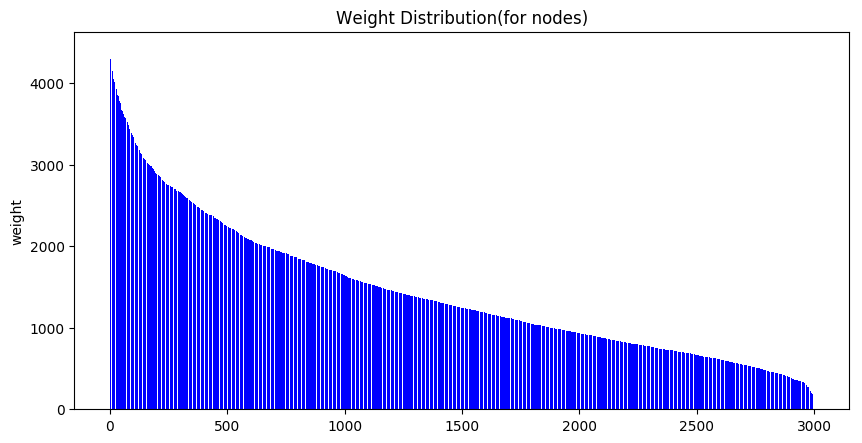

In [29]:
plt.figure(figsize=(10, 5), dpi= 100)
plt.bar(range(len(sorted_weight_dis)),sorted_weight_dis, align='center' , color = 'blue')
plt.title('Weight Distribution(for nodes)')
plt.ylabel('weight')
plt.show()

In [31]:
#create bins
bin1 = sorted(list(set(weight_dis)))

#count frequencies
counter=collections.Counter(weight_dis)
counter = sorted(counter.items())
#split in the list of degrees and counts
x, y = zip(*counter)

Text(0.5,1,'Weight Distribution (for nodes)')

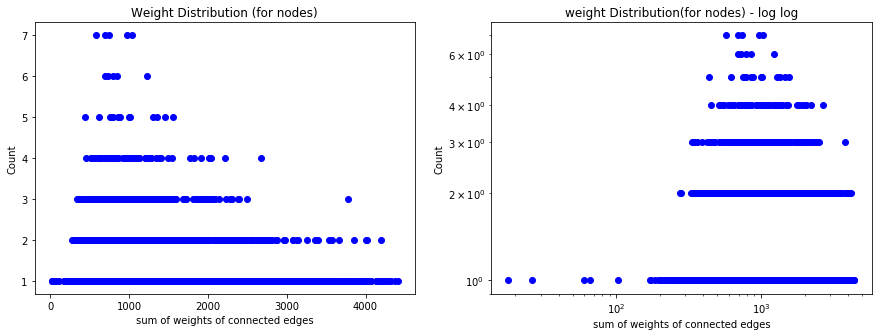

In [32]:
fig, axes = plt.subplots(nrows=1, ncols=2,figsize=(15,5))
ax1, ax0 = axes.flatten()

ax0.scatter(x,y, c='blue')
ax0.set_yscale('log')
ax0.set_xscale('log')
ax0.set(ylabel='Count')
ax0.set(xlabel='sum of weights of connected edges')
ax0.set_title('weight Distribution(for nodes) - log log')

ax1.scatter(x,y, c='blue')
ax1.set(ylabel='Count')
ax1.set(xlabel='sum of weights of connected edges')
ax1.set_title('Weight Distribution (for nodes)')

In [33]:
print('Minimum degree in network: '+ str(min(weight_dis)))
print('Maximum degree in network:' + str(max(weight_dis)))
print('Mean degree in network: '+ str(np.mean(weight_dis)))

Minimum degree in network: 18
Maximum degree in network:4409
Mean degree in network: 1435.7933333333333


<a id="FC"></a>

## Fans Communities
We used the Louvain Community detection algorithm for finding our communities. As the weight statics shown below, **mean of the weights is 2.25**. We decided to remove the edges with weight **less than 3**, In order to find more concreate communities, the resulting graph contains **190210 edges**. communities are plotted bellow.

In [34]:
#finding the max, min and mean of the edges weights

weights = dict(nx.get_edge_attributes(new_G, 'weight'))

weights_for_edges_dis = list(weights.values())
sorted_weights_for_edges_dis = sorted(weights_for_edges_dis, reverse=True)

print('Minimum degree in network: '+ str(min(weights_for_edges_dis)))
print('Maximum degree in network:' + str(max(weights_for_edges_dis)))
print('Mean degree in network: '+ str(np.mean(weights_for_edges_dis)))

Minimum degree in network: 1
Maximum degree in network:86
Mean degree in network: 2.2547548778917417


In [60]:
projected_graph = new_G.copy()

#find the edges with wight under 3
first_node = list()
second_node = list()
i = 0
for node1,node2 in projected_graph.edges():
    n = list((projected_graph.get_edge_data(node1,node2)).values())
    if n[0] < 3:
        first_node.append(node1)
        second_node.append(node2)
    else:
        i += 1

In [61]:
#edges under 3
removing_edges = list(zip(first_node,second_node))

#remove the removing edges
projected_graph.remove_edges_from(removing_edges)

print('mumber of edges: ' + str(projected_graph.number_of_edges()))

mumber of edges: 190210


In [62]:
#finding the communities
partition = community.best_partition(projected_graph)

In [63]:
#making a dictionary of nodes and their weight to make the size of the node 
node_weight_projected = dict((key, value) for (key, value) in zip(list(projected_graph.nodes()),[0]*3000)) #

weights_projected = dict(nx.get_edge_attributes(projected_graph, 'weight'))

for key,values in weights_projected.items():
    node_weight_projected[key[0]] += values
    node_weight_projected[key[1]] += values

#making the node size list proportinal to weight
nodeSize = list(node_weight_projected.values())
nodeSize = [size/10 for size in nodeSize]

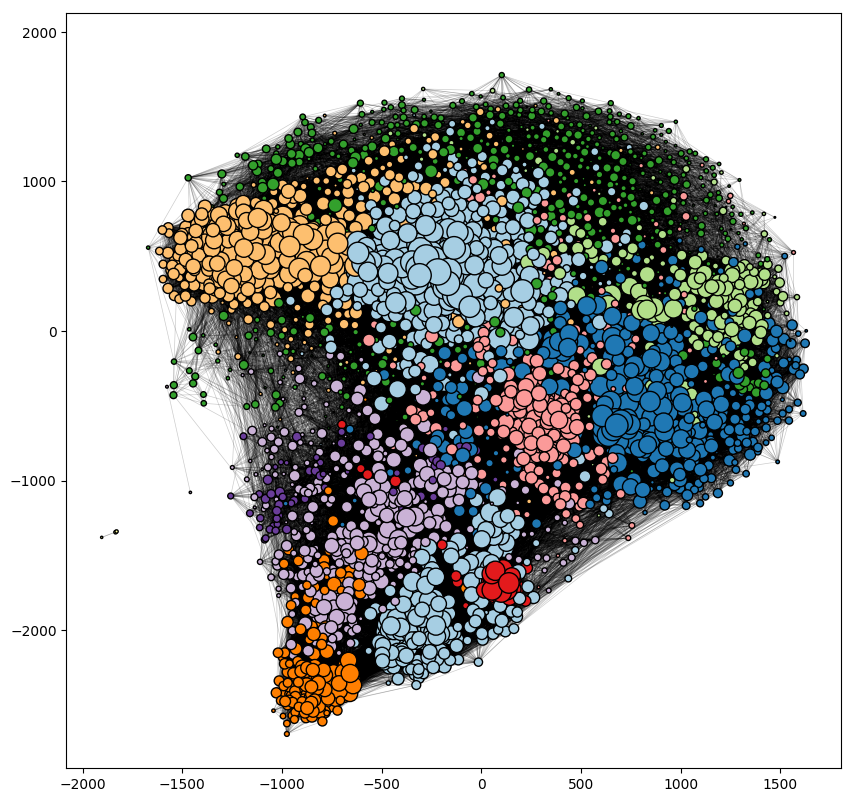

In [64]:
#allocating colors to communities
community_color = [None] * len(partition)
i=0
for person in partition.keys():
    community_color[i] = (float(partition[person]))*2
    i = i+1

#ploting the communities

plt.figure(num=None, figsize=(10, 10), dpi=100, facecolor='w', edgecolor='k')
cmap1 = plt.get_cmap('Paired')
nx.draw_networkx_nodes(projected_graph, positions, with_labels=True, nodelist=list(projected_graph.nodes()), node_color=community_color, cmap =cmap1, edgecolors="black", node_size = nodeSize) 
nx.draw_networkx_edges(projected_graph, positions, alpha=0.2, edge_color="black", width=0.5, edgelist=projected_graph.edges())

plt.show()

In [65]:
#find the number of communities
number_of_communities = len(set(list(partition.values())))
print('number of communities: '+ str(number_of_communities))

number of communities: 14


We can see that communities mostly contains the nodes with almost the same node size (which is proportional to the weights of the nodes) which may indicate that communities contains the books which are as popular as each other. To gain a better insight into these communities, we done some text analysise on descriptions, tags and reviews of the books in each community. 
<a id="FND"></a>

## Descriptions
To find out what communities are about we analysied the descriptions. For each community a document is created, containing the descriptions of the 50 top books in the community. Then **TF-IDF** is calculated to compare the content of decriptions and creating **word clouds**.

We used **langdetect** library to find **only English** description to avoid the appearance of stopwords from different languages in our word cloud and to understand the world clouds better.

In [69]:
#fans communities sorted by weights in each community
with open('sorted_community_weights', 'rb') as f:
     sorted_community_weights = pickle.load(f)

In [67]:
#this file contains the description 
with open('DFdescriptions_reviews_names', 'rb') as f:
    orginal_title = pickle.load(f)

In [70]:
#finding the top 50 only english descriptions for each community
#description_for_top dictionary : key = community number       value = list of top 50 books decriptions 

description_for_top = defaultdict(list)  
j = 0 #community id
for community in sorted_community_weights:
    if len(community) > 50 :
        i = 0 # for counting the top 
        for key,value in community.items():
            temp = list((orginal_title.loc[orginal_title['bookID']== int(key[1:])]).description)
            try: #might need to use try-except because it throws errors for weird texts (numbers, emoji...)
                language = detect(temp[0])
                if(language == 'en'):
                    description_for_top[j].extend(temp)
            except:
                continue

            i += 1  
            if i == 50:
                break   
    else:
           for key,value in community.items():
                temp = list((orginal_title.loc[orginal_title['bookID']== int(key[1:])]).description)
                try: #might need to use try-except because it throws errors for weird texts (numbers, emoji...)
                    language = detect(temp[0])
                    if(language == 'en'):
                        description_for_top[j].extend(temp)
                except:
                    continue
    j +=1
description_for_top = dict(description_for_top)

In [71]:
#cleaning the descriptions to make word cloud

#Set everything to lower case.
for key,value in description_for_top.items():
    description_for_top[key] =  [ w.lower() for w in description_for_top[key]]

# remove  punctuation
for key,value in description_for_top.items():
    tokens = nltk.word_tokenize(str(description_for_top[key])) 
    tokens = [x for x in tokens if len(re.findall(r'[^a-zA-Z_]',x)) == 0]
    description_for_top[key] = tokens

# remove stop words
from nltk.corpus import stopwords
stopset = set(stopwords.words('english'))
for key,value in description_for_top.items():
    description_for_top[key] =  [ w for w in  description_for_top[key] if w not in stopset]

#Exclude numbers
for key,value in description_for_top.items():
    description_for_top[key] = [re.sub("\d+", "", w) for w in description_for_top[key]]

#removing null cells
for key,value in description_for_top.items():
    for word in description_for_top[key]:
        if word == '':
            description_for_top[key].remove(word)

In [72]:
#calculating TF_IDF

# finding frequency for each word for each community
fre_commun = list()
for key,value in description_for_top.items():
    fre_commun.append(nltk.FreqDist(description_for_top[key]))

#find a set of all words
words = list()
for community in fre_commun:
    words.extend((dict(community)).keys())
words = set(words)

#IDF
idf = dict()
for word in words:
    i = 0 
    for community in fre_commun:
        words_in_community = list(dict(community).keys())
        if word in set(words_in_community):
            i +=1
            
    idf[word] = (np.log(len(fre_commun)/float(i)))
    
#TF_IDF
TF_IDF_for_comunnities = list()
for comminity in fre_commun:
    TF_IDF = dict()
    for word,freq in comminity.items():
        x = float(idf[word])
        TF_IDF[word] = x*float(freq)*100
        
    TF_IDF_for_comunnities.append(TF_IDF)


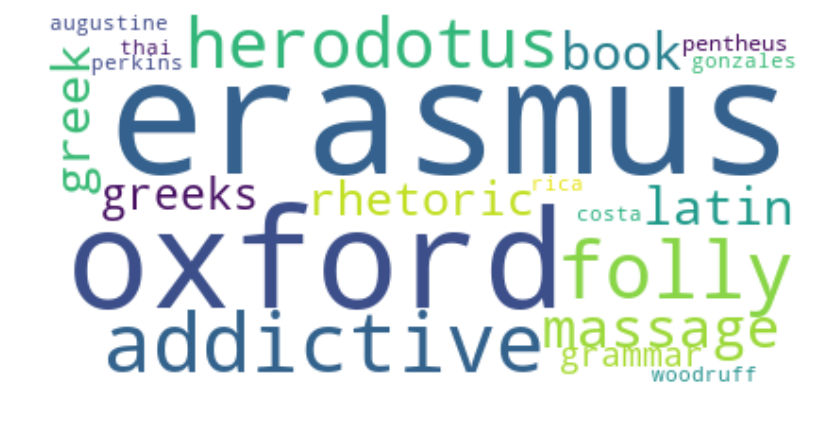

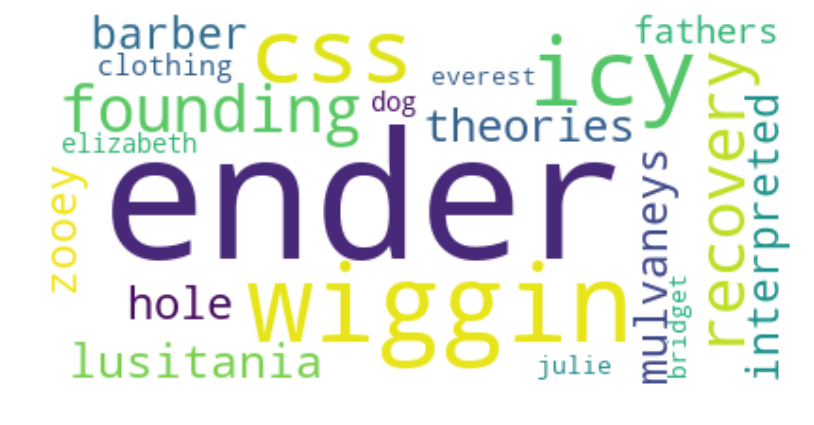

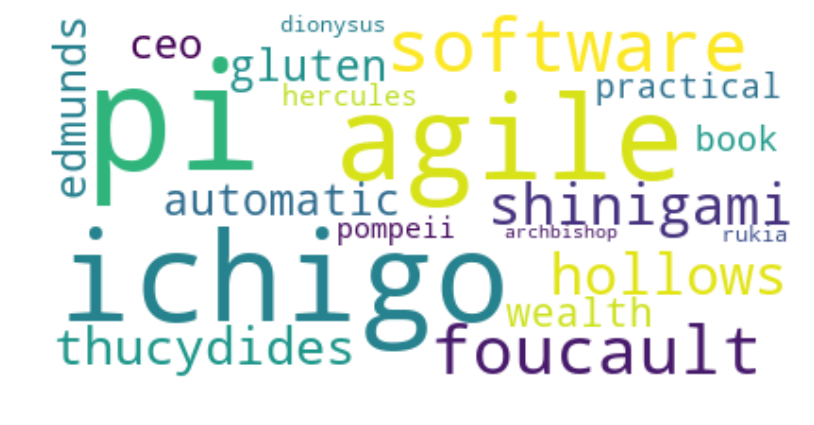

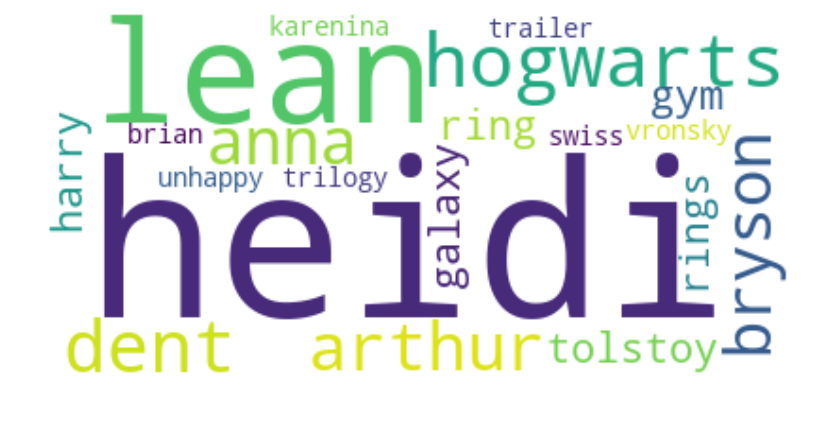

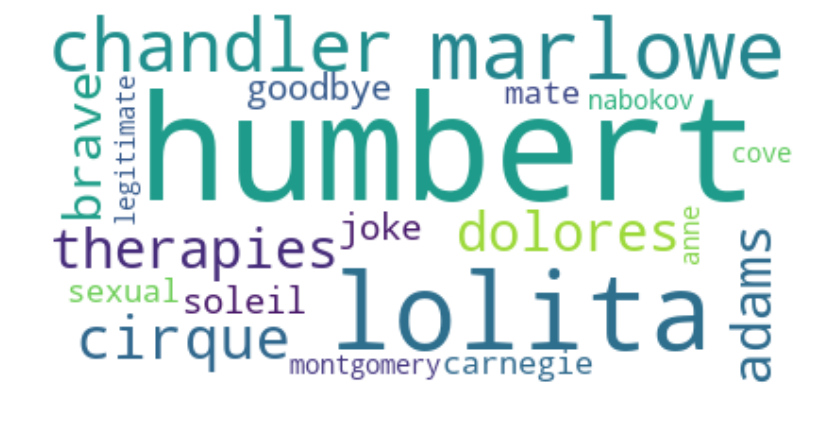

...

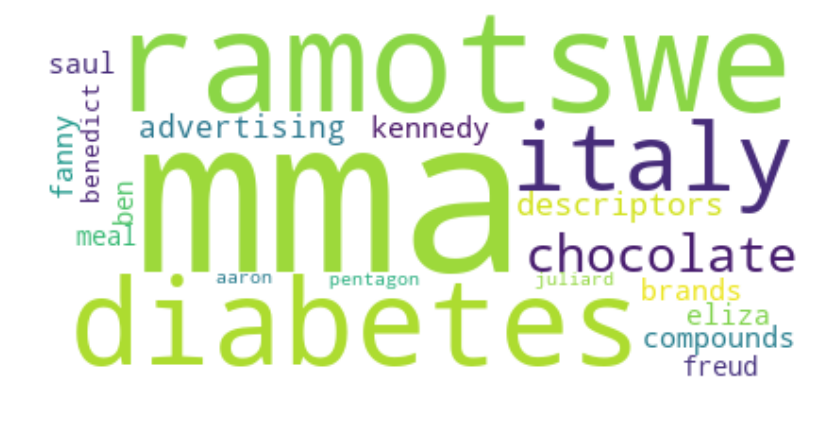

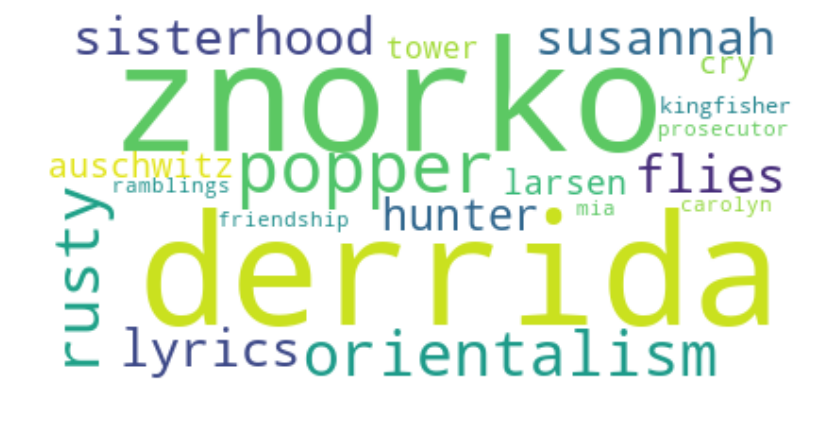

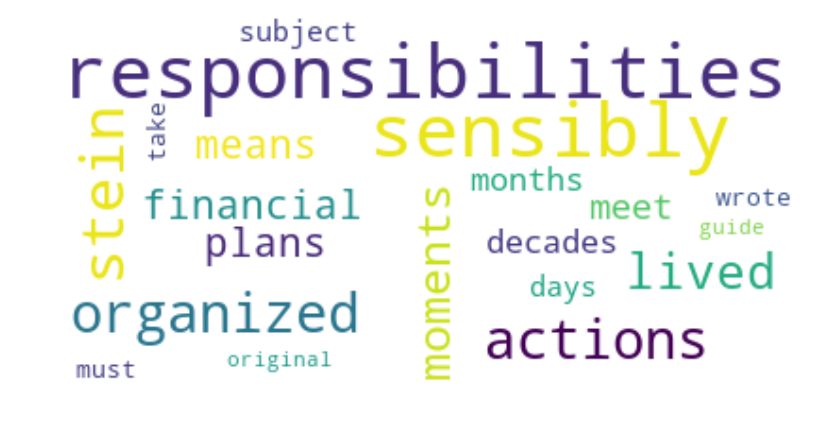

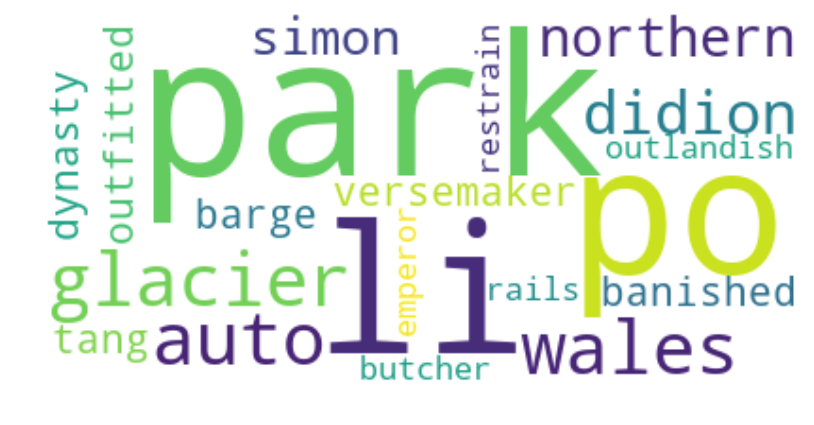

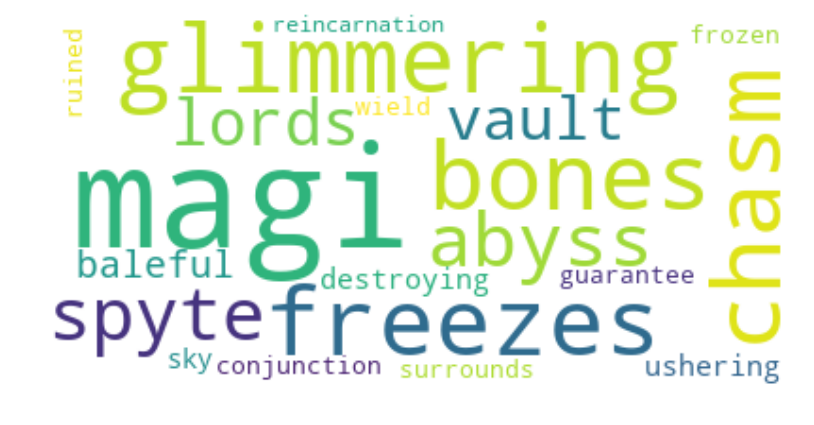

In [74]:
#Creating word clouds
for community in TF_IDF_for_comunnities:
    community = sorted(community.items(), key=operator.itemgetter(1), reverse =True)[:20]
    community = [(key,int(math.floor(value))) for key,value in community]
    community = dict(community)
    plt.figure(figsize=(10, 5), dpi= 100)
    wordcloud = WordCloud(background_color="white").generate_from_frequencies(community)
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()
    

<a id="FNT"></a>

## Tags
We want to look at tags that users give to the books to find out what are the most important tags within the communities. We want to use that information to interpret what are the common topics in the communities, why the same people read these books.

In the [Data Notebook ](https://nbviewer.jupyter.org/github/MonikaF/booknetwork/blob/master/explainer%20notebooks/EXPLAINER_notebook_DATA.ipynb?flush_cache=true)
you can see how we pre-processed tag data. As the result we have Pandas dataframe with top 5 most frequent tags for each book.

We pool together tags of 50 most connected books in each community and create a word clouds of the most frequent tags. 

By chosing the tags of only 50 books, we can get better interpretable results. We assume that since these books have the highest sum of their edges weight, they were read by significant number of people within the community, thus they can reflect it's nature.

In [3]:
#load file with top 5 tags for each books
with open('.\\data\\DF_top5_tags.pkl', 'rb') as f:
    top5 = pickle.load(f)
top5.head()

,goodreads_book_id,tag_id,count,tag_name
37602,4953,11743,1409,fiction
37604,4953,19733,1195,memoir
37605,4953,21689,1076,non-fiction
37606,4953,21773,553,nonfiction
37607,4953,19742,347,memoirs


In [8]:
#load file with fan communities
with open('data\\sorted_community_weights.pkl', 'rb') as f:
    com_fan = pickle.load(f)

We use several helper functions:

In [4]:
#this function returns list of most 
def getCommunityTagsPOPULAR(book_IDS):
    ids = book_IDS
    #get tags for the community
    idxs_1 = top5["goodreads_book_id"].isin(ids)
    tags_1 = top5[idxs_1]
    COMMUNITY_TAGS = tags_1.groupby(['tag_name']).sum().reset_index()
    COMMUNITY_TAGS = COMMUNITY_TAGS.drop(columns=['tag_id', 'goodreads_book_id'])
    COMMUNITY_TAGS = COMMUNITY_TAGS.sort_values(by=['count'],ascending=False)
    return COMMUNITY_TAGS

In [25]:
#this function finds NR of most connected books within a community (community = list of books sorted by weight)
def mostConnectedBooks(nr, community):
    topbooks = list()
    i = 0
    for key,value in community.items():
        topbooks.append(key[1:])
        i += 1
        if i == nr:
            break      
    return topbooks

In [6]:
#this function prints a word cloud of tags
def makeWordCloud(COMMUNITY_TAGS): 
    #create dictionary of tag counts - for wordcloud
    d = dict()
    for row in COMMUNITY_TAGS.itertuples():
        tag = row[1]
        cnt = row[2]
        d[tag] = cnt
        
    #make wordcloud    
    wc = WordCloud(background_color="white",width=800, height=400,colormap=plt.cm.Reds,collocations=False)
    wc.generate_from_frequencies(d)
    
    plt.figure(figsize=(8,4))
    plt.imshow(wc,interpolation='bilinear')
    plt.axis("off")
    plt.show()

At last, we print word clouds for each community.
As you can see, the word clouds describe genres within communities quite well. We can see that communities contain combinations several different topics which are often related. Such as:
- ficiton - classics - school
- biography - history - non-fiction
- horror - fiction - fantasy

COMMUNITY 0:


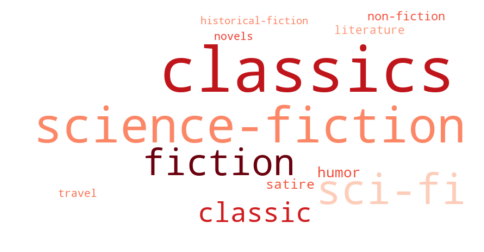

COMMUNITY 1:


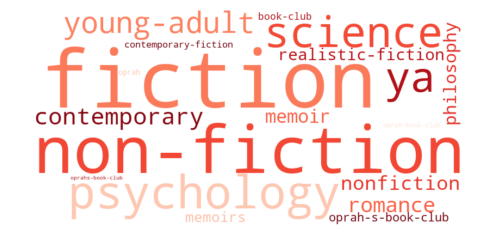

COMMUNITY 2:


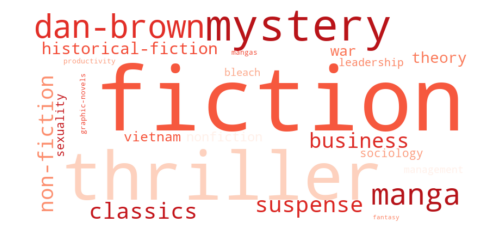

COMMUNITY 3:


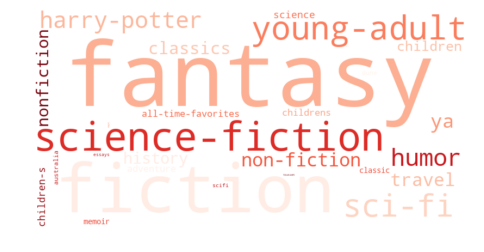

COMMUNITY 4:


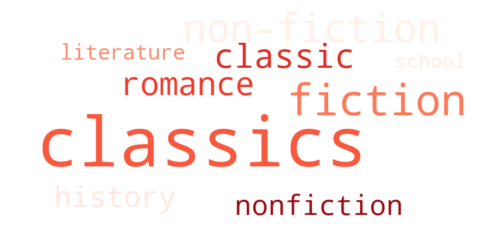

COMMUNITY 5:


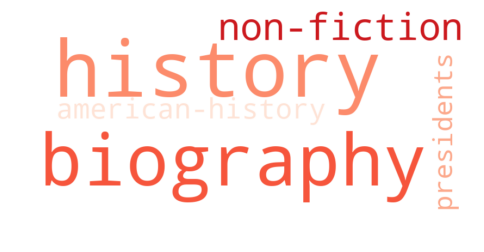

COMMUNITY 6:


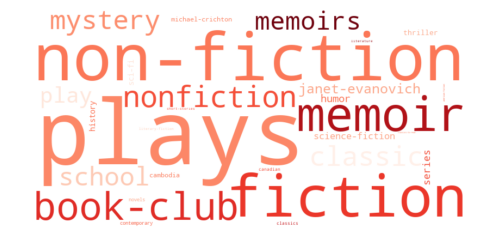

COMMUNITY 7:


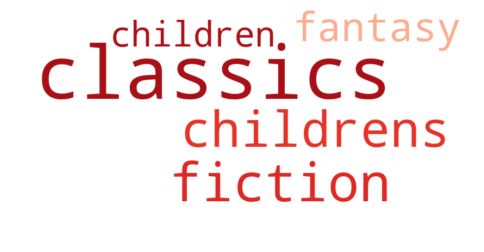

COMMUNITY 8:
COMMUNITY 9:


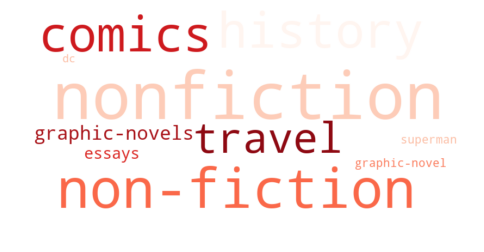

COMMUNITY 10:


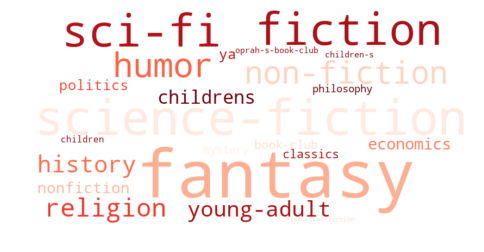

COMMUNITY 11:


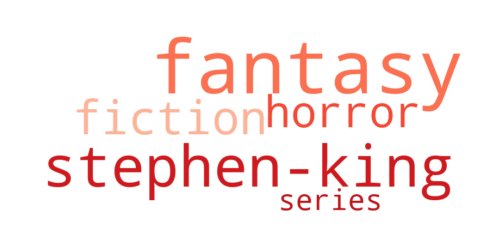

In [26]:
#we omitt last 3 communities from analysis because they are too small.
for c in range(0, len(com_fan[:-3])):
    print("COMMUNITY %d:"%c)
    topbooks = mostConnectedBooks(50, com_fan[c])
    COMMUNITY_TAGS = getCommunityTagsPOPULAR(topbooks)
    if len(COMMUNITY_TAGS) == 0:
        continue
    makeWordCloud(COMMUNITY_TAGS)

<a id="FNR"></a>

## Reviews
In this step, we will do a text analysis of reviews of books in communities. We want to see why people like these books, therefore we will take reviews with **positive sentiment** and calculate **TF-IDF**. The TF-IDF algorithm allows us to find frequent words, which are also uniqe for each community. We will show our results as **word clouds**.



We use 
- NTLK library for tokenization
- langdetect library to find reviews written in English 
- LabMT wordlist - to help detecting sentiment [Temporal Patterns of Happiness and Information in a Global Social Network: Hedonometrics and Twitter (Data Set S1)](https://journals.plos.org/plosone/article?id=10.1371/journal.pone.0026752)

We've created several helper functions for analysing reviews:
- **tokenizeReviews** - tokenizetion function which creates tokens, sets everything to lowercase, remove punctuation and numbers and exclude stopwords
- **calc_sentiment** - calculates average sentiment for list of tokens using list of 'happiness words'
- **FIND_POSITIVE_REVIEWS** - finds reviews within the community which have sentiment higher than *mean+1.5std*

In [18]:
#tokenizetion function
def tokenizeReviews(text):

    #create tokens
    tokens = nltk.word_tokenize(text) 

    #to lowercase
    tokens = [w.lower() for w in tokens]

    #exclude punctuation and numbers
    tokens = [x for x in tokens if len(re.findall(r'[^a-zA-Z_]',x)) == 0]

    #exclude stowords
    stopw = stopwords.words('english')
    tokens = [x for x in tokens if x not in stopw]
    my_stopw = ["https", "tf", "rt", "http"]
    tokens = [x for x in tokens if x not in my_stopw]
    
    return tokens

In [19]:
#calculates average sentiment for list of tokens using list of 'happiness words'
def calc_sentiment(tokens,word_happiness):
    hap_avg = [word_happiness[t] for t in tokens if t in word_happiness.keys()]
    
    if len(hap_avg)>0:
        return sum(hap_avg)/len(hap_avg)
    else:
        return 0

    return hap_avg.mean()

In [21]:
def FIND_POSITIVE_REVIEWS(bookID_list):
    communities_reviews = list()
    non_english_languages = list()
    #get reviews for the community
    idxs = data["bookID"].isin(bookID_list)
    books = data[idxs]
    
    all_revs = list()
    
    for row in books.itertuples():
        all_revs.append(row[3][:30]) #max 20 reviews for each book
        
    #sentiment
    
    #create dict for sentiment
    word_happiness={}
    for word in labmt['word']:
        word_idx = labmt[labmt['word']==word].index[0]
        word_happiness[word] = labmt.loc[word_idx,'happiness_average']
        
    # calculate sentiment for each REVIEW - result is list of lists of reviews and list of lists of sentiments
    community_sentiments = list()
    community_reviews = list()
    for book in all_revs:
        book_sentiments = list()
        book_reviews = list()
        for r in book:
            if(len(r)>0):
                try:
                    #print(detect(r))
                    if(detect(r) == 'en'):
                        tokens = tokenizeReviews(r) # tokenize the review
                        sentiment = calc_sentiment(tokens,word_happiness) #calculate sentiment
                        if(sentiment != 0):#consider only non zero sentiment
                            book_sentiments.append(sentiment)
                            book_reviews.append(tokens)
                    else:
                        non_english_languages.append(detect(r))
                except:
                    continue
                    
        if(len(book_sentiments)>0): 
            community_sentiments.append(book_sentiments)
            community_reviews.append(book_reviews)
    
    #find overal mean and std
    flat = list()
    for c in community_sentiments:
        flat.extend(c)
        
    all_sentiments = np.array(flat)
    mean = all_sentiments.mean()
    std = all_sentiments.std()
    
    #positive reviews threshold
    thr = (mean+1.5*std)
    
    # and pick just reviews with high sentiment
    community_positive_reviews = list()
    community_positive_sentiments = list()
    
    for i in range(len(community_sentiments)):
        positive_reviews = list()
        positive_sentiments = list()
        
        for r in range(len(community_sentiments[i])):
            if community_sentiments[i][r] > thr: #sentiments higher than threshold
                positive_reviews.append(community_reviews[i][r])
                positive_sentiments.append(community_sentiments[i][r])
                
        community_positive_reviews.append(positive_reviews)
        community_positive_sentiments.append(positive_sentiments)
    return  non_english_languages,community_positive_reviews, community_positive_sentiments

Load data

In [30]:
#get reviews
data = pd.read_pickle(".\\data\\DFdescriptions_reviews_names")

#load sentiment data
labmt = pd.read_csv(".\\data\\sentiment.csv")

Create list of positive reviews for 50 most connected books

In [ ]:
REVIEWS_LIST = list()
nr_com = len(com_fan[:-3]) # number of communities

#for
for c in range(0,nr_com):
    #find ids of 50 most connected books
    ids = mostConnectedBooks(50, com_fan[c])
    
    #find positive reviews
    community_positive_reviews, community_positive_sentiments = FIND_POSITIVE_REVIEWS(ids)
    
    #flatten reviews into one list
    reviews = list()
    for r in community_positive_reviews:
        for l in r:
            reviews.extend(l)
        
    REVIEWS_LIST.append(reviews)   

Calculate TF-IDF for the reviews and create wordclouds for each community

In [ ]:
# finding frequency for each word for each community
frequencies = list()
for community in REVIEWS_LIST:
    frequencies.append(nltk.FreqDist(community))

#find a set of all words
words_set = list()
for community in REVIEWS_LIST:
    words_set.extend(community)
words_set = set(words_set)

#find set of words for each community
community_set = list()
for community in REVIEWS_LIST:
    community_set.append(set(community))
    
#calulate IDF
idf = dict()
for word in words_set:
    i = 0 
    for community in community_set:
        if word in community:
            i +=1
            
    idf[word] = (np.log(nr_com/float(i)))
    
#CALCULATE TF IDF
TF_IDF_for_comunnities = list()

for com_freq in frequencies:
    TF_IDF = dict()
    for word in com_freq:
        freq = com_freq[word]
        IDF = float(idf[word])
        TF_IDF[word] = IDF*float(freq)*100
        
    TF_IDF_for_comunnities.append(TF_IDF)

### Results
As you can see in the results, the words mostly reflect the content of the books in communities that is mentioned in the positive reviews. It can be difficult to interpret why people liked these books. However the results can be used to further explain what topic are relevant in the community together with descriptions and tags. 
The better usage of sentiment analysis would be to compare how the average review sentiment for each community differs from the average sentiment of all reviews - this way we could see which communities are regarded more positively than the others. 

Community 0: 


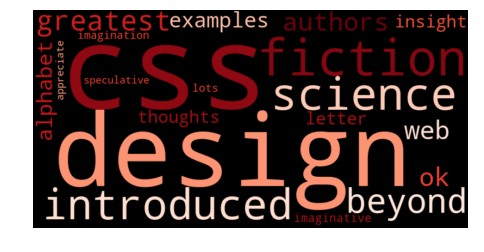

Community 1: 


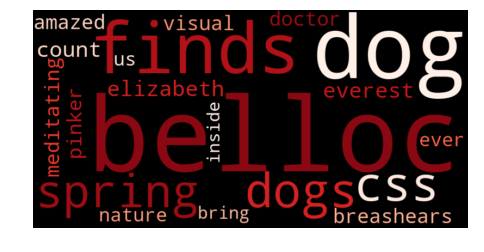

Community 2: 


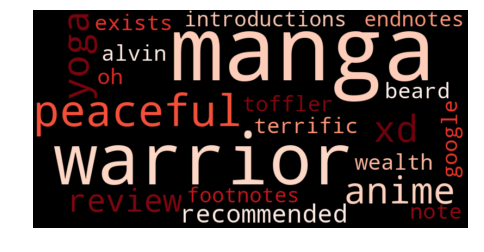

Community 3: 


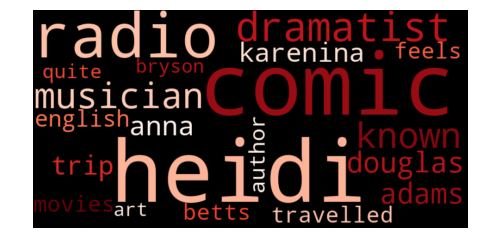

Community 4: 


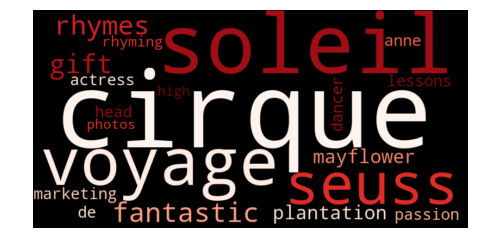

Community 5: 


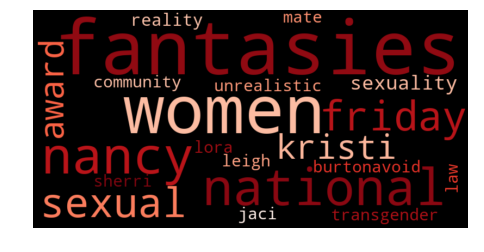

Community 6: 


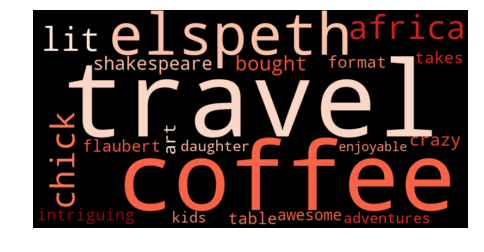

Community 7: 


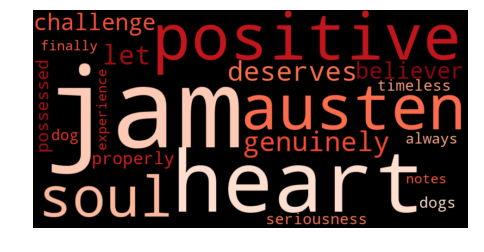

Community 8: 


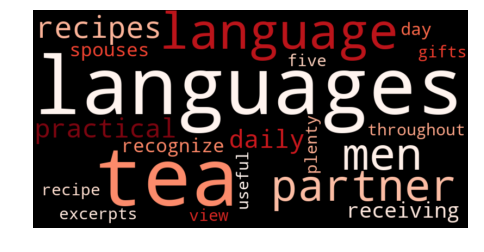

Community 9: 


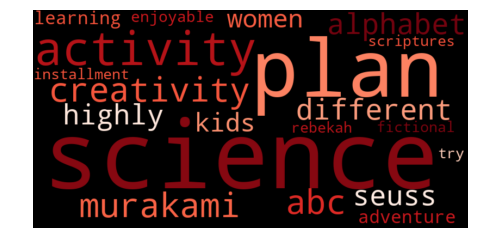

Community 10: 


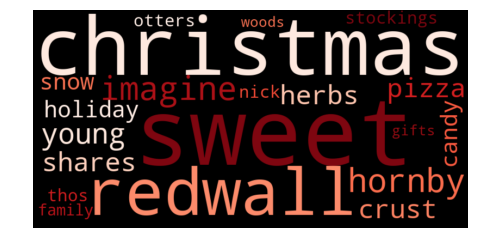

Community 11: 


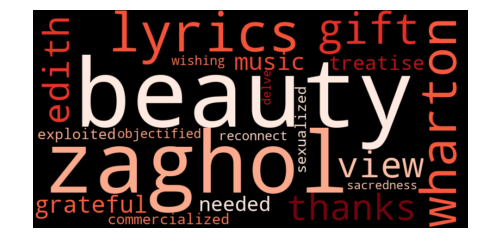

In [108]:
#print wordcloud for each community
i = 0
for community in TF_IDF_for_comunnities:
    print("Community %d: "%i)
    makeWordCloud(community)
    i+=1

<a id="FNL"></a>

## Languages In Communities
We suspect that maybe our communities are books in different languages, to check our hypothesis we detect the languages of the descriptions in each community, large portion of books descriptions was in English in all communities. then we decide to check whether some communities are more popular for some nationalities or not, to investigate that concept we find the number of non english reviews for books in each community.

In [75]:
#fans communities
with open('sorted_community_weights', 'rb') as f:
     fan_communities = pickle.load(f)

In [76]:
#get reviews
data = pd.read_pickle("/home/elika/uni/network/project/DFdescriptions_reviews_names")
#load sentiment data
labmt = pd.read_csv("/home/elika/uni/network/project/file.csv")

In [77]:
# a function which returns the non English languages for reviews of a list of book ids
def find_reviews(bookID):
     #get reviews for the community
    idxs = data["bookID"].isin(bookID)
    books = data[idxs]
    non_english_languages = list()
    all_revs = list()
    
    for row in books.itertuples():
        all_revs.append(row[3])      
        
    for book in all_revs:
        for r in book:
            if(len(r)>0):
                try:
                    #print(detect(r))
                    if(detect(r) != 'en'):
                        non_english_languages.append(detect(r))
                except:
                    continue
    return non_english_languages

community0


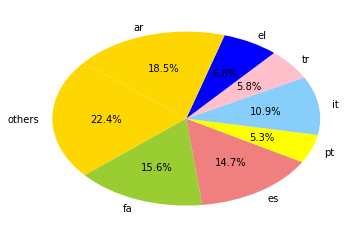

community1


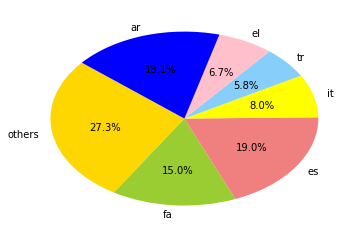

community2


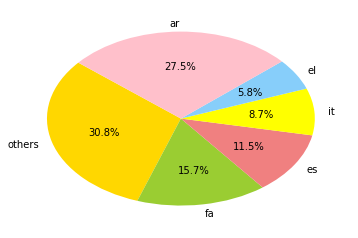

community3


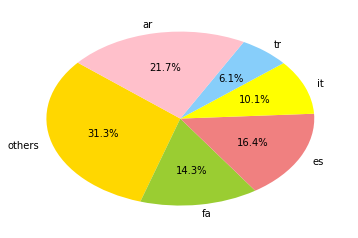

community4


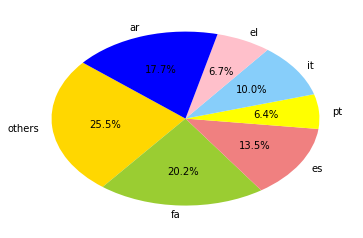

community5


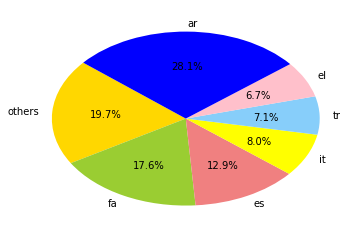

community6


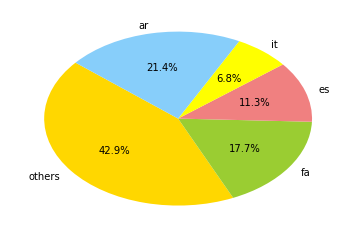

community7


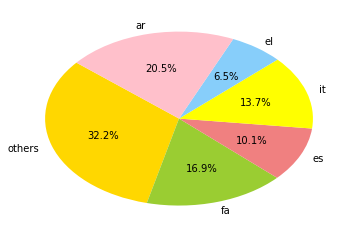

community8


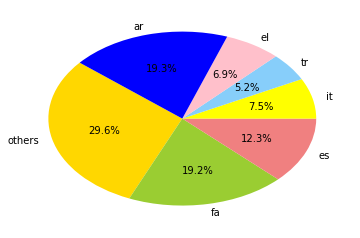

community9


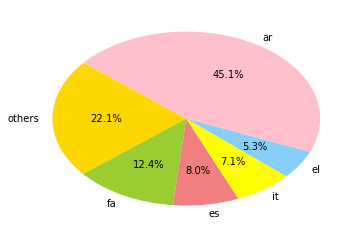

community10


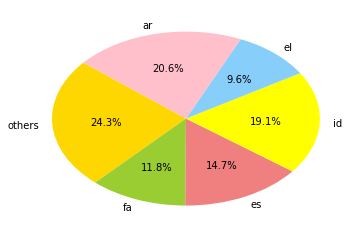

community11


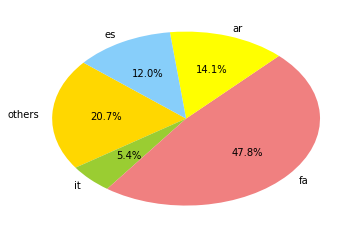

community12


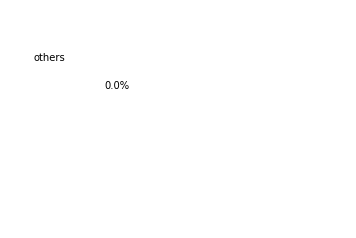

community13


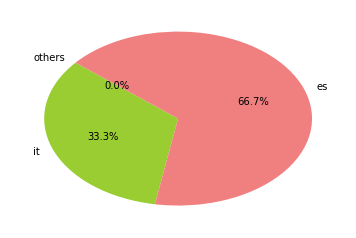

community14


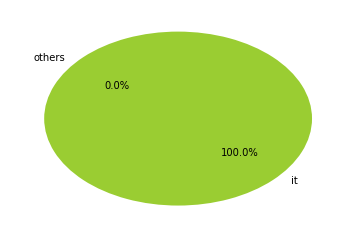

In [78]:
#making pie chart to see the distributin of different languages
i = 0
for community in fan_communities:
        bookid_list = list(community.keys())
        bookid_list = [book_id[1:] for book_id in bookid_list ]
        languages = find_reviews(bookid_list[:])
        count_lan = dict()
        count_lan['others'] =0
        different_lan = set(languages)
        for di_lan in different_lan:
            temp = languages.count(di_lan)
            if float(temp)*100/float(len(languages)) < 5: 

                count_lan['others'] += temp
            else:
                count_lan[di_lan]  = temp
        labels = list(count_lan.keys())
        sizes = list(count_lan.values())
        colors = ['gold', 'yellowgreen', 'lightcoral','yellow', 'lightskyblue','pink','blue']

        plt.pie(sizes, labels=labels, shadow=False, startangle=140, colors=colors,
        autopct='%1.1f%%')
        #print(languages)
        print('community' + str(i))
        plt.show()
        i += 1
        
        

Languages with less than 5% are all collected in others. We can see that most non english reviews are in Espanish, Arabic and Farsi (persion), this may indicate that good read's most non English users speaks in these languages. However, in community 9 and 11 we see huge increase in arabic and farsi languages which prove our hypothesis in some communities. Also, we can see that the books in community 6 is been read by people in many more different languages. last three communities contains less than 5 books and we can't rely on them.
<a id="HN"></a>

# Haters Network
For the 3k most popular books we consider the ratings 1 and 2, then we done the exact same procedure.

In [153]:
#select only ratings < 3
low_ratings = books_rating.loc[books_rating['rating']<3]


## Bipartite Graph

1. **Nodes**: 3k most popular book + users who hated the books
2. **Edges**: Users is connected to the books they hate

In [154]:
#create bipartite network - runs 5-10min
bipartite = nx.Graph()
book_nodes = set()
user_nodes = set()


for index, row in low_ratings.iterrows():
    b = low_ratings.at[index,'book_id']
    u = low_ratings.at[index,'user_id']
    
    # book ids and user ids can be the same! - name books and user nodes using different prefix 
    book = "B"+str(b)
    user = "U"+str(u)
    
    bipartite.add_edge(book,user)
    book_nodes.add(book)
    user_nodes.add(user)

In [107]:
print("Number of nodes: "+ str(bipartite.number_of_nodes()))

print('Number of edges: ' + str(bipartite.number_of_edges()))

Number of nodes: 8795
Number of edges: 11440


In [145]:
forceatlas2 = ForceAtlas2(
                        # Behavior alternatives
                        outboundAttractionDistribution=False,  # Dissuade hubs
                        linLogMode=False,  # NOT IMPLEMENTED
                        adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
                        edgeWeightInfluence=1.0,

                        # Performance
                        jitterTolerance=1.0,  # Tolerance
                        barnesHutOptimize=False,
                        barnesHutTheta=1.2,
                        multiThreaded=False,  # NOT IMPLEMENTED

                        # Tuning
                        scalingRatio=1.0,
                        strongGravityMode=False,
                        gravity=60.0, #1.0,

                        # Log
                        verbose=False)
positions2 = forceatlas2.forceatlas2_networkx_layout(bipartite, pos=None, iterations=500)
    

In [157]:
# #storing positions for bipartie graph
# with open('EN_N_for_biparite.pkl', 'wb') as f:
#     pickle.dump(positions2, f)

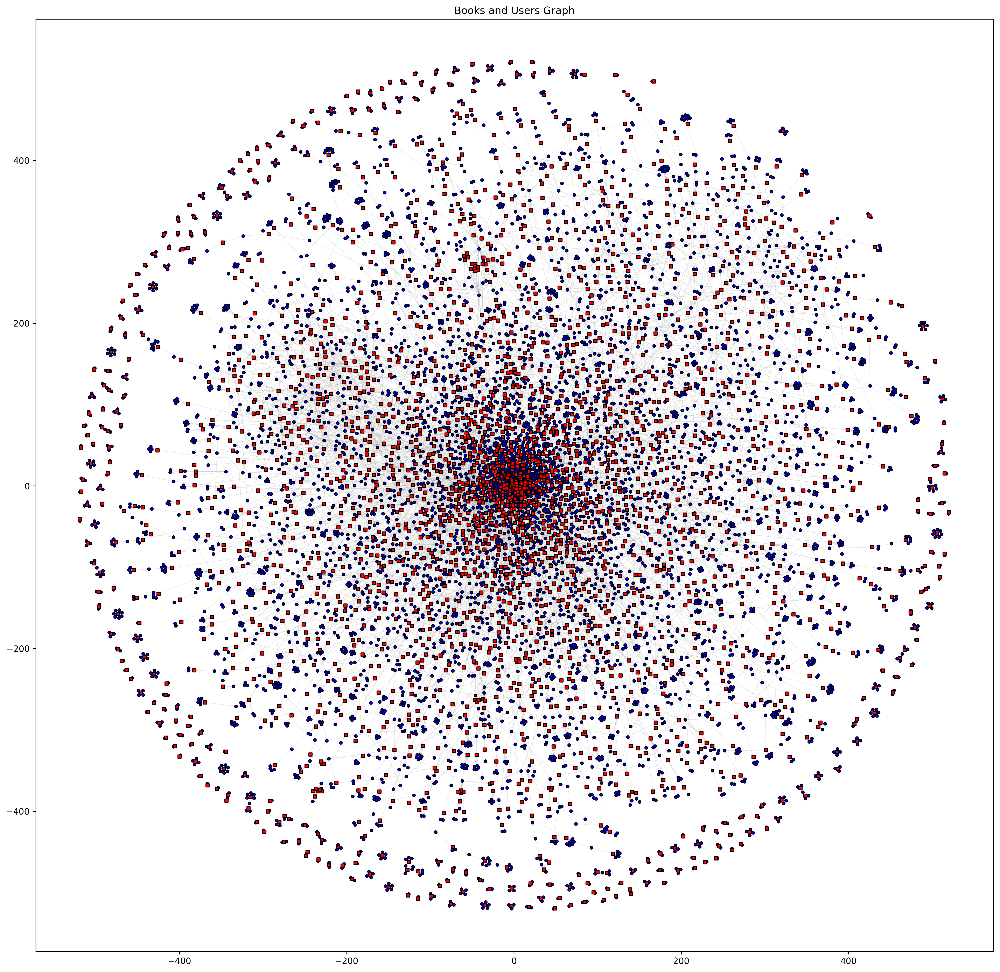

In [156]:
plt.figure(num=None, figsize=(20, 20), dpi=300, facecolor='w', edgecolor='k')

nx.draw_networkx_nodes(bipartite, positions2, with_labels=False, nodelist=user_nodes, node_color="blue", edgecolors="black", node_size = 10 ,node_shape="o")
nx.draw_networkx_nodes(bipartite, positions2, with_labels=False, nodelist=book_nodes, node_color="red", edgecolors="black", node_size = 15,node_shape="s" )


nx.draw_networkx_edges(bipartite, positions2, alpha=0.2, edge_color="gray", width=0.5, edgelist=bipartite.edges())



plt.title("Books and Users Graph")
plt.show()

## Projected Graph
The bipartite graph is projected on books, in the resulting graph two books are connected if same person rated them both less than 3. Weights of the edges indicate the number of people who rated both books the same.
The Haters graph contains 2137 nodes (single nodes are removed) and 19901 edges. it is plotted below with the node size proportional to degree.

In [109]:
#projecting 
new_G = nx.bipartite.weighted_projected_graph(bipartite.to_undirected(), book_nodes, ratio=False)

for nodes in list(new_G.nodes()):
    if new_G.degree(nodes) < 3:
        new_G.remove_node(nodes)

In [110]:

forceatlas2 = ForceAtlas2(
                         # Behavior alternatives
                          outboundAttractionDistribution=False,  # Dissuade hubs
                          linLogMode=False,  # NOT IMPLEMENTED
                          adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
                          edgeWeightInfluence=1.0,

                          # Performance
                          jitterTolerance=1.0,  # Tolerance
                          barnesHutOptimize=False,
                          barnesHutTheta=1.2,
                          multiThreaded=False,  # NOT IMPLEMENTED

                          # Tuning
                          scalingRatio=1.0,
                          strongGravityMode=False,
                          gravity=60.0, #1.0,

                          # Log
                          verbose=False)
positions3 = forceatlas2.forceatlas2_networkx_layout(new_G, pos=None, iterations=5000)
    

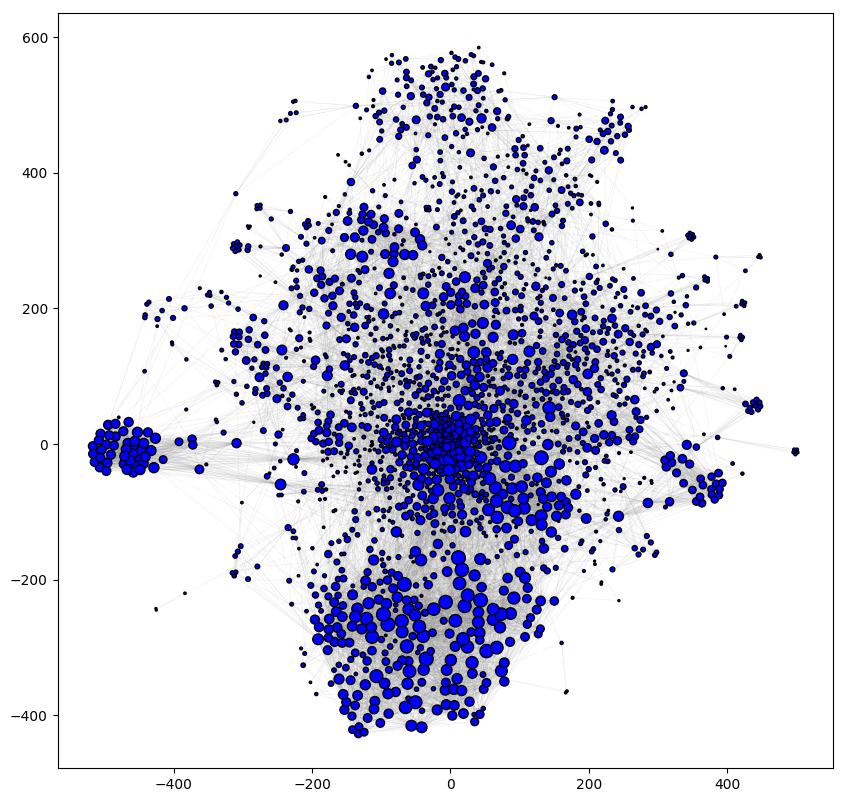

In [111]:
#making node size list proportional to the degree of nodes
node_size = list(dict(new_G.degree()).values())


plt.figure(num=None, figsize=(10, 10), dpi=100, facecolor='w', edgecolor='k')

nx.draw_networkx_nodes(new_G, positions3, with_labels=True, nodelist=list(new_G.nodes()), node_color="blue", edgecolors="black", node_size = node_size) 
nx.draw_networkx_edges(new_G, positions3, alpha=0.1, edge_color="gray", width=0.5, edgelist=new_G.edges())

plt.show()

In [87]:
#number of nodes
print('number of nodes: ' + str(new_G.number_of_nodes()))

#number of edges
print('number of edges: ' + str(new_G.number_of_edges()))

number of nodes: 2136
number of edges: 19900


<a id="HNS"></a>

## Network statistics
### Degree Distribution

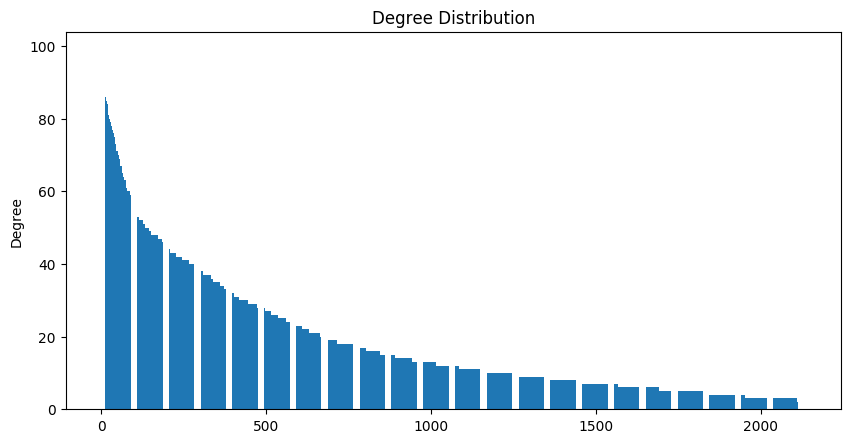

In [88]:
#sorting the degree distribution
degree_dis = list(dict(new_G.degree()).values())
sorted_degree_dis = sorted(degree_dis, reverse=True)

#ploting the degree Distribution
plt.figure(figsize=(10, 5), dpi= 100)
plt.bar(range(len(sorted_degree_dis)),sorted_degree_dis, align='center')
plt.title('Degree Distribution')
plt.ylabel('Degree')
plt.show()

Text(0.5,1,'Degree Distribution')

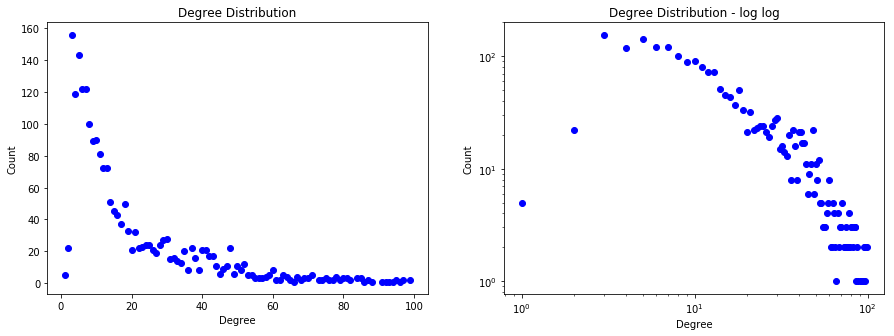

In [91]:
#create bins
bin1 = sorted(list(set(degree_dis)))

#count frequencies
import collections
counter=collections.Counter(degree_dis)
counter = sorted(counter.items())
#split in the list of degrees and counts
x, y = zip(*counter)

fig, axes = plt.subplots(nrows=1, ncols=2,figsize=(15,5))
ax1, ax0 = axes.flatten()

ax0.scatter(x,y, c='blue')
ax0.set_yscale('log')
ax0.set_xscale('log')
ax0.set(ylabel='Count')
ax0.set(xlabel='Degree')
ax0.set_title('Degree Distribution - log log')

ax1.scatter(x,y, c='blue')
ax1.set(ylabel='Count')
ax1.set(xlabel='Degree')
ax1.set_title('Degree Distribution')

In [90]:
print('Minimum degree in network: '+ str(min(degree_dis)))
print('Maximum degree in network:' + str(max(degree_dis)))
print('Mean degree in network: '+ str(np.mean(degree_dis)))

Minimum degree in network: 1
Maximum degree in network:99
Mean degree in network: 18.632958801498127


### Weight Distribution

In [92]:
#ploting weight distribution for nodes(sum the weights on edges connected to node)

node_weight = dict((key, value) for (key, value) in zip(list(new_G.nodes()),[0]*3000)) #

weights = dict(nx.get_edge_attributes(new_G, 'weight'))
for key,values in weights.items():
    node_weight[key[0]] += values
    node_weight[key[1]] += values

weight_dis = list(node_weight.values())
sorted_weight_dis = sorted(weight_dis, reverse=True)

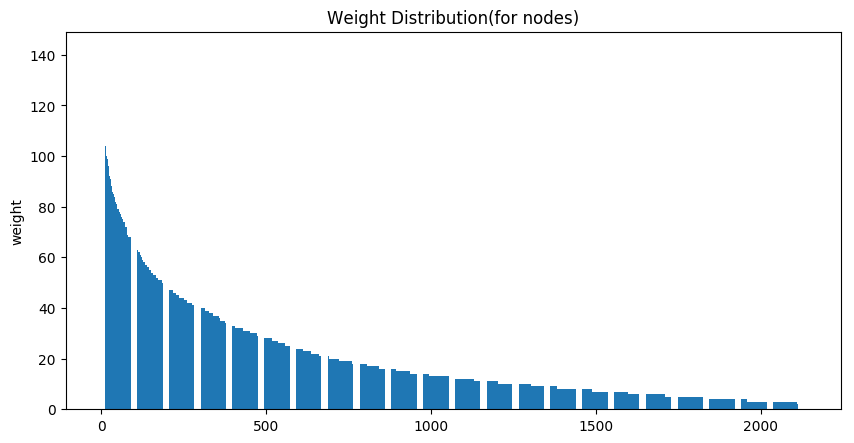

In [93]:
plt.figure(figsize=(10, 5), dpi= 100)
plt.bar(range(len(sorted_weight_dis)),sorted_weight_dis, align='center')
plt.title('Weight Distribution(for nodes)')
plt.ylabel('weight')
plt.show()

Text(0.5,1,'Weight Distribution (for nodes)')

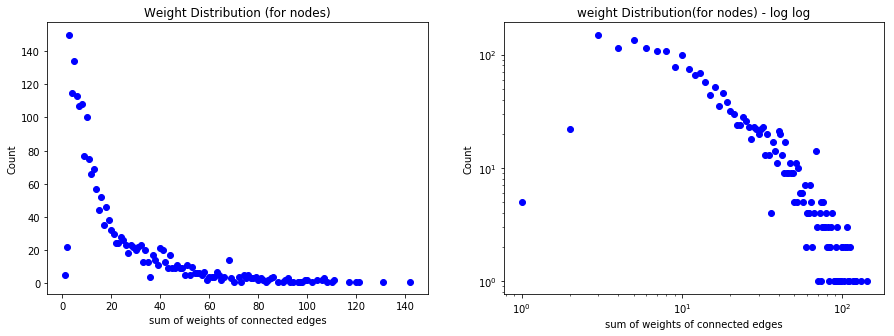

In [95]:
#create bins
bin1 = sorted(list(set(weight_dis)))

#count frequencies
import collections
counter=collections.Counter(weight_dis)
counter = sorted(counter.items())
#split in the list of degrees and counts
x, y = zip(*counter)

fig, axes = plt.subplots(nrows=1, ncols=2,figsize=(15,5))
ax1, ax0 = axes.flatten()

ax0.scatter(x,y, c='blue')
ax0.set_yscale('log')
ax0.set_xscale('log')
ax0.set(ylabel='Count')
ax0.set(xlabel='sum of weights of connected edges')
ax0.set_title('weight Distribution(for nodes) - log log')

ax1.scatter(x,y, c='blue')
ax1.set(ylabel='Count')
ax1.set(xlabel='sum of weights of connected edges')
ax1.set_title('Weight Distribution (for nodes)')

In [94]:
print('Minimum degree in network: '+ str(min(weight_dis)))
print('Maximum degree in network:' + str(max(weight_dis)))
print('Mean degree in network: '+ str(np.mean(weight_dis)))

Minimum degree in network: 1
Maximum degree in network:142
Mean degree in network: 20.103932584269664


<a id="HNC"></a>

## Haters Communities

In [114]:
projected_graph = new_G.copy()

#making a dictionary of nodes and their weight
node_weight_projected = dict((key, value) for (key, value) in zip(list(projected_graph.nodes()),[0]*3000)) #

weights_projected = dict(nx.get_edge_attributes(projected_graph, 'weight'))

for key,values in weights_projected.items():
    node_weight_projected[key[0]] += values
    node_weight_projected[key[1]] += values
    
#making the node size list proportinal to weight
nodeSize = list(node_weight_projected.values())

#finding the communities
partition = community.best_partition(projected_graph)

#allocating colors to communities
community_color = [None] * len(partition)
i=0
for person in partition.keys():
    community_color[i] = (float(partition[person]))*2
    i = i+1

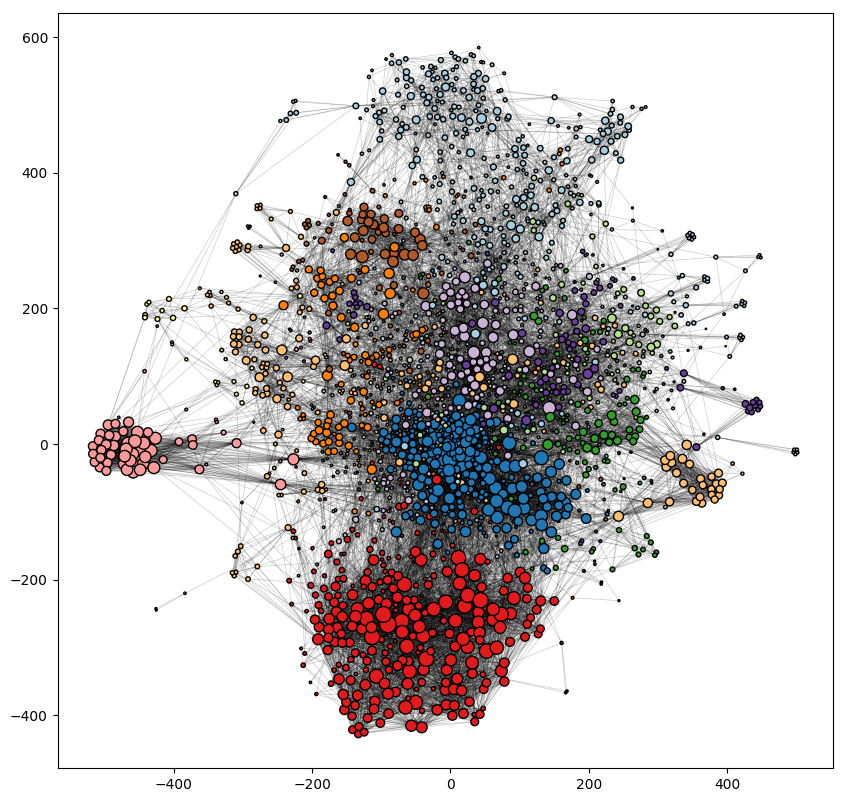

In [115]:
plt.figure(num=None, figsize=(10, 10), dpi=100, facecolor='w', edgecolor='k')

cmap1 = plt.get_cmap('Paired')
nx.draw_networkx_nodes(projected_graph, positions3, with_labels=True, nodelist=list(projected_graph.nodes()), node_color=community_color, cmap =cmap1, edgecolors="black", node_size = nodeSize) 
nx.draw_networkx_edges(projected_graph, positions3, alpha=0.2, edge_color="black", width=0.5, edgelist=projected_graph.edges())

plt.show()

<a id="HND"></a>

## Descriptions

In [116]:
#this file contains the description 
with open('DFdescriptions_reviews_names', 'rb') as f:
    orginal_title = pickle.load(f)

In [119]:
#'Haters_communities'
with open('sorted_Haters_community_weights.pkl', 'rb') as f:
    sorted_community_weights = pickle.load(f)

In [120]:
#finding the top 50 only english descriptions for each community
#description_for_top dictionary : key = community number       value = list of top 50 books decriptions 

description_for_top = defaultdict(list)  
j = 0 #community id
for community in sorted_community_weights:
    if len(community) > 50 :
        i = 0 # for counting the top 
        for key,value in community.items():
            temp = list((orginal_title.loc[orginal_title['bookID']== int(key[1:])]).description)
            try: #might need to use try-except because it throws errors for weird texts (numbers, emoji...)
                language = detect(temp[0])
                if(language == 'en'):
                    description_for_top[j].extend(temp)
            except:
                continue

            i += 1  
            if i == 50:
                break   
    else:
           for key,value in community.items():
                temp = list((orginal_title.loc[orginal_title['bookID']== int(key[1:])]).description)
                try: #might need to use try-except because it throws errors for weird texts (numbers, emoji...)
                    language = detect(temp[0])
                    if(language == 'en'):
                        description_for_top[j].extend(temp)
                except:
                    continue
    j +=1
description_for_top = dict(description_for_top)

In [121]:
#cleaning the descriptions to make word cloud

#Set everything to lower case.
for key,value in description_for_top.items():
    description_for_top[key] =  [ w.lower() for w in description_for_top[key]]

# remove  punctuation
for key,value in description_for_top.items():
    tokens = nltk.word_tokenize(str(description_for_top[key])) 
    tokens = [x for x in tokens if len(re.findall(r'[^a-zA-Z_]',x)) == 0]
    description_for_top[key] = tokens

# remove stop words
from nltk.corpus import stopwords
stopset = set(stopwords.words('english'))
for key,value in description_for_top.items():
    description_for_top[key] =  [ w for w in  description_for_top[key] if w not in stopset]

#Exclude numbers
for key,value in description_for_top.items():
    description_for_top[key] = [re.sub("\d+", "", w) for w in description_for_top[key]]

#removing null cells
for key,value in description_for_top.items():
    for word in description_for_top[key]:
        if word == '':
            description_for_top[key].remove(word)

In [122]:
#calculating TF_IDF

# finding frequency for each word for each community
fre_commun = list()
for key,value in description_for_top.items():
    fre_commun.append(nltk.FreqDist(description_for_top[key]))

#find a set of all words
words = list()
for community in fre_commun:
    words.extend((dict(community)).keys())
words = set(words)

#IDF
idf = dict()
for word in words:
    i = 0 
    for community in fre_commun:
        words_in_community = list(dict(community).keys())
        if word in set(words_in_community):
            i +=1
            
    idf[word] = (np.log(len(fre_commun)/float(i)))
    
#TF_IDF
TF_IDF_for_comunnities = list()
for comminity in fre_commun:
    TF_IDF = dict()
    for word,freq in comminity.items():
        x = float(idf[word])
        TF_IDF[word] = x*float(freq)*100
        
    TF_IDF_for_comunnities.append(TF_IDF)


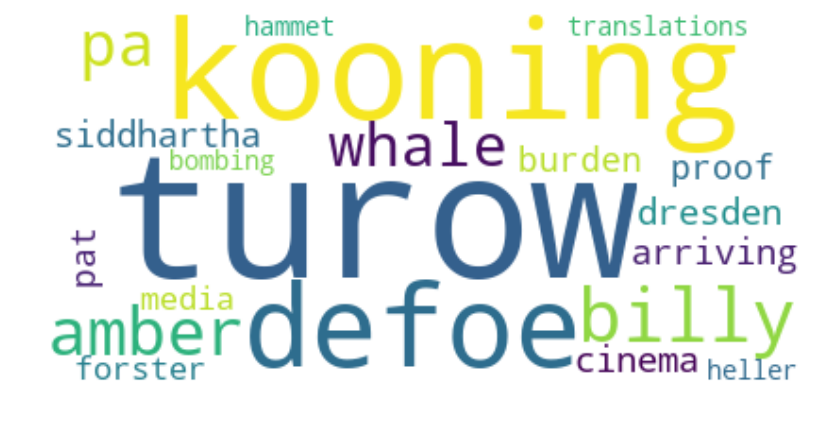

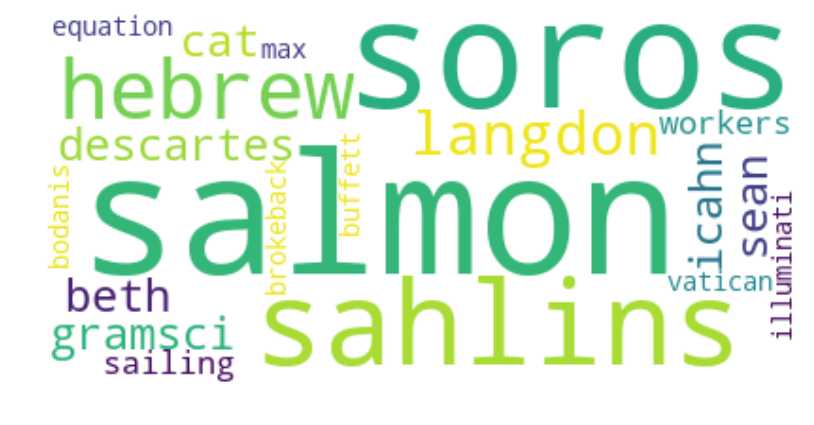

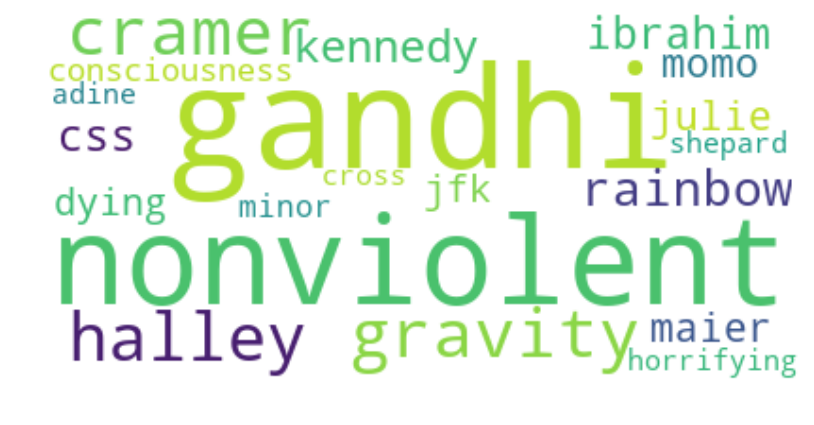

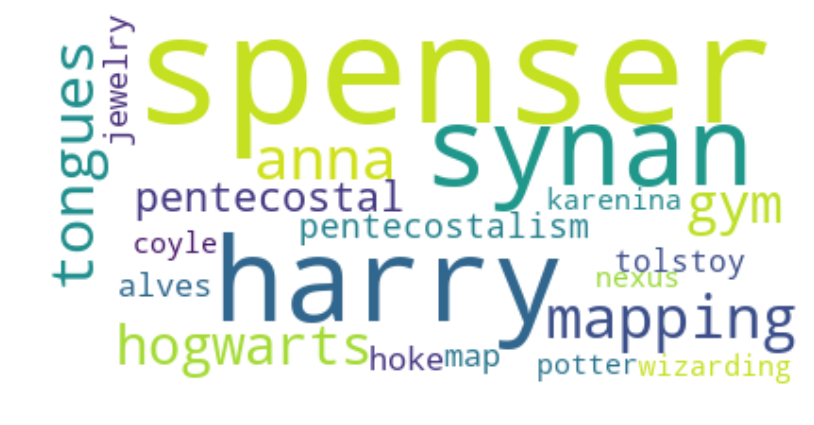

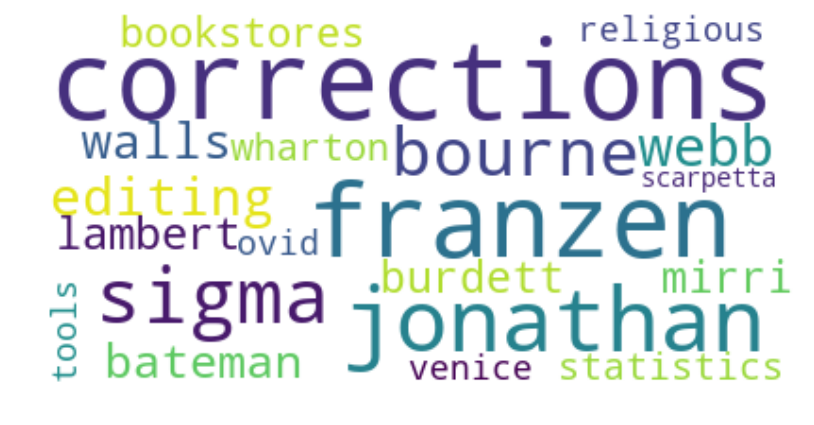

...

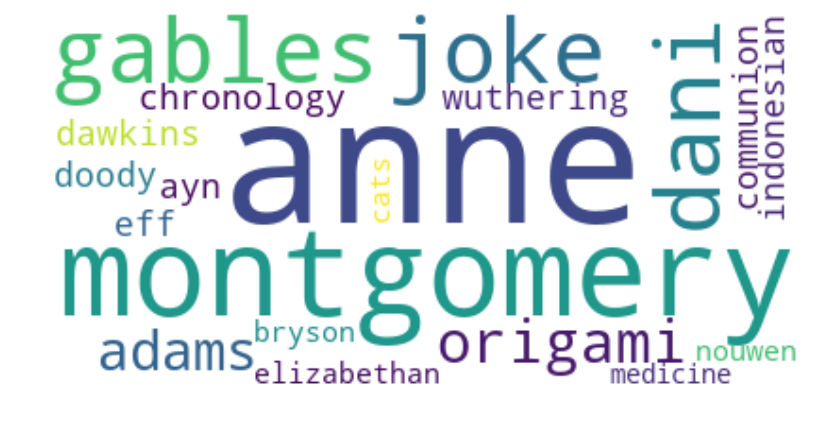

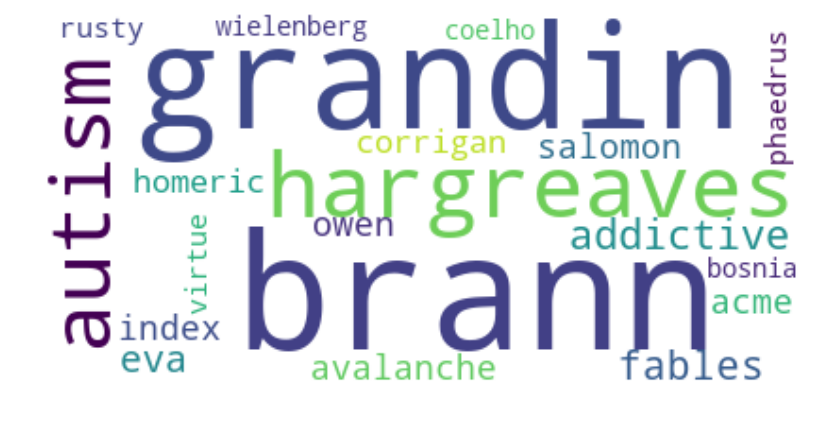

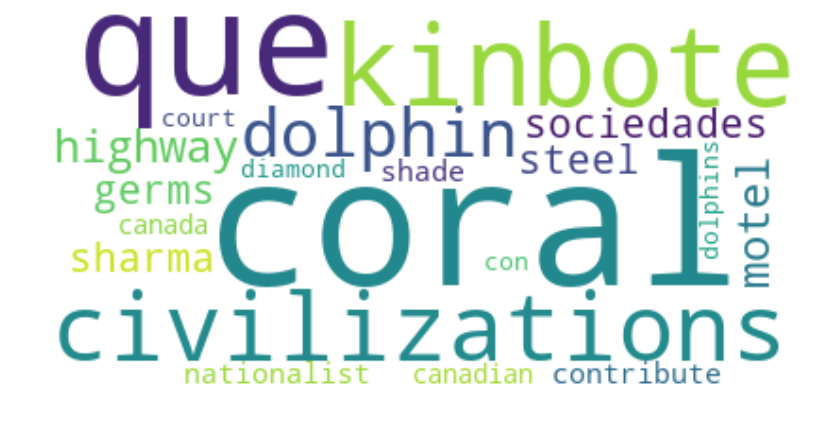

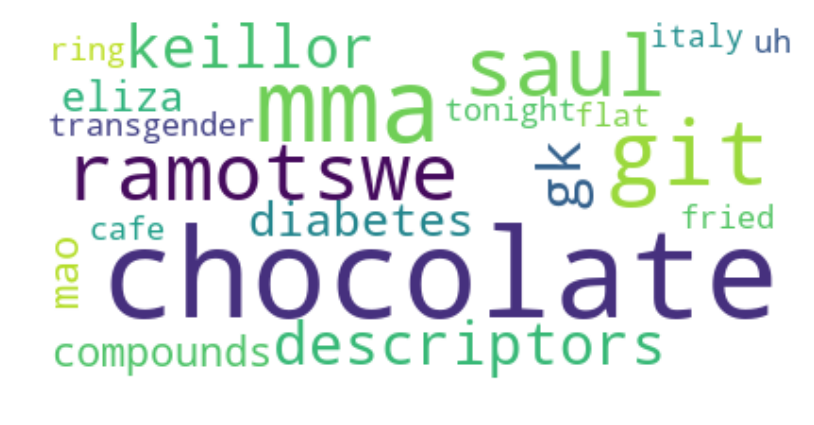

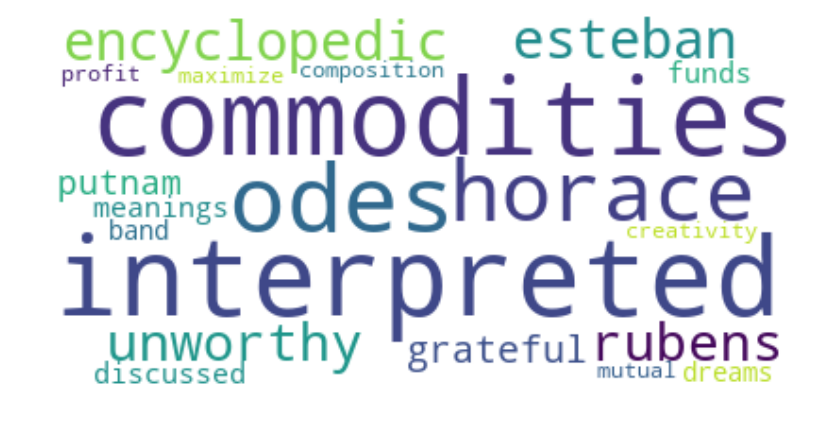

In [123]:
#Creating word clouds
for community in TF_IDF_for_comunnities:
    community = sorted(community.items(), key=operator.itemgetter(1), reverse =True)[:20]
    community = [(key,int(math.floor(value))) for key,value in community]
    community = dict(community)
    plt.figure(figsize=(10, 5), dpi= 100)
    wordcloud = WordCloud(background_color="white").generate_from_frequencies(community)
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()
    

<a id="HNT"></a>

## Tags
- we performed analysis of tags in Haters communities in the same way as we did for fans

Similar to the Fan network, the tags within a Hater community include a several different topics. However it is more challenging to find an overlaying theme, since the books Hater communities seem to be less related by genre. It makes sense since disliking a book is probably more random occurance than liking one. When we like a book, we try to find other books that are similar and we will probably like them as well. However reading a book you don't like is more of a bad luck, since it probably seemed to be interesting at first glance.

Here you can see the results:

COMMUNITY 0:


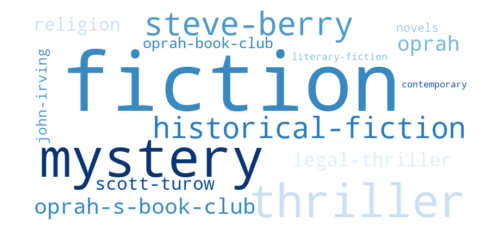

COMMUNITY 1:


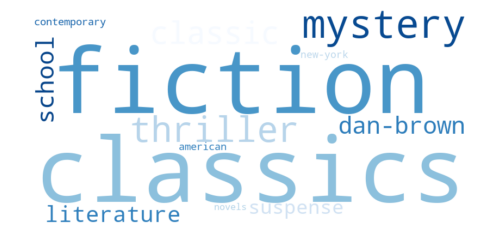

COMMUNITY 2:


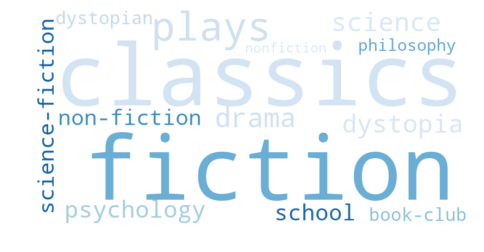

COMMUNITY 3:


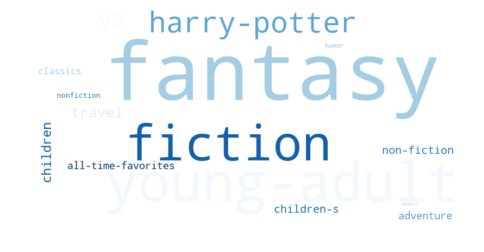

COMMUNITY 4:


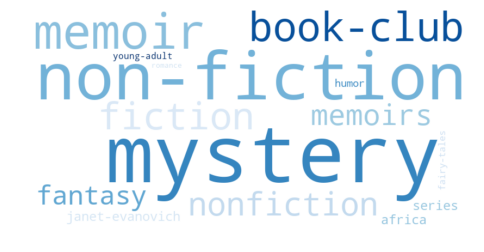

COMMUNITY 5:


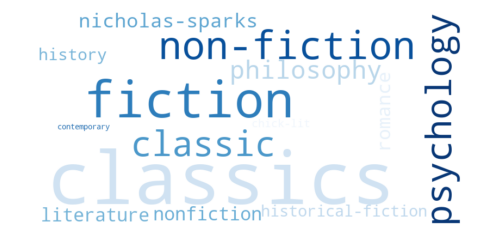

COMMUNITY 6:


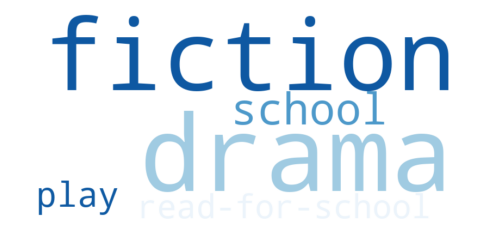

COMMUNITY 7:


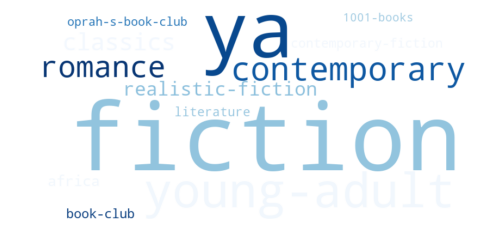

COMMUNITY 8:


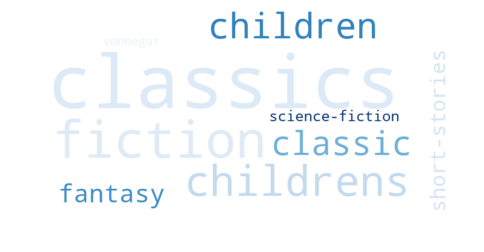

COMMUNITY 9:


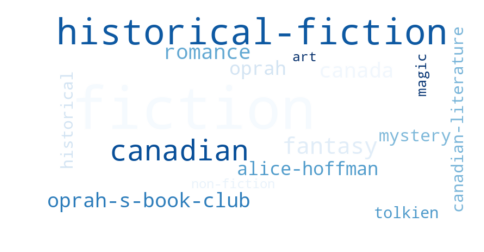

COMMUNITY 10:


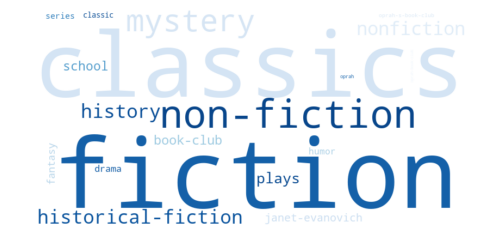

COMMUNITY 11:


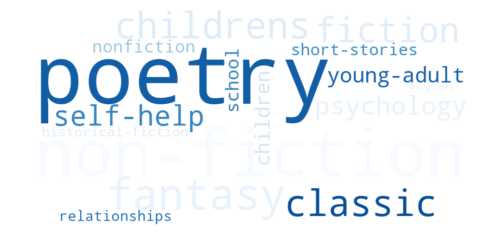

COMMUNITY 12:


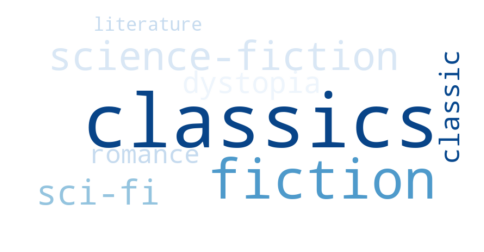

COMMUNITY 13:


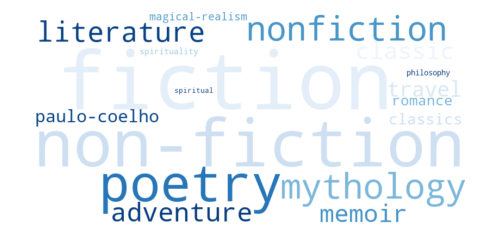

COMMUNITY 14:


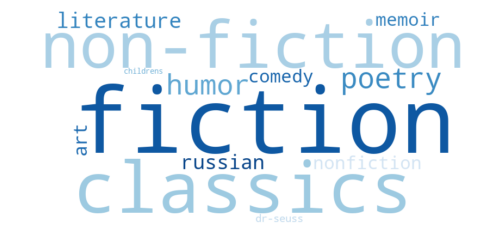

COMMUNITY 15:


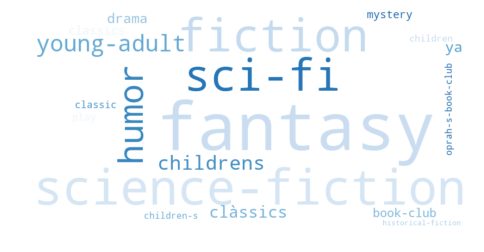

COMMUNITY 16:


In [269]:
for c in range(0, len(com_hater)):
    print("COMMUNITY %d:"%c)
    topbooks = mostConnectedBooks(c, 50, com_hater)
    COMMUNITY_TAGS = getCommunityTagsPOPULAR(topbooks)
    makeWordCloudBlu(COMMUNITY_TAGS)

<a id="HNR"></a>

## Reviews
- we analyzed reviews for Hater communities in the same way as for Fan communities. The only change we introduced is that we took reviews with low sentiment - lower than threshold of **mean-1.5std**

The results are similar to the fan network. the words mostly reflect the content of the books in communities that is mentioned in the negative reviews. It can be difficult to interpret why people hated these books.

In [139]:
def FIND_NEGATIVE_REVIEWS(bookID_list):
    communities_reviews = list()

    #get reviews for the community
    idxs = data["bookID"].isin(bookID_list)
    books = data[idxs]
    
    all_revs = list()
    
    for row in books.itertuples():
        all_revs.append(row[3][:20]) #max 20 reviews for each book
    
    #create dict for sentiment
    word_happiness={}
    for word in labmt['word']:
        word_idx = labmt[labmt['word']==word].index[0]
        word_happiness[word] = labmt.loc[word_idx,'happiness_average']
        
    # calculate sentiment for each REVIEW - result is list of lists of reviews and list of lists of sentiments
    community_sentiments = list()
    community_reviews = list()
    for book in all_revs:
        book_sentiments = list()
        book_reviews = list()
        for r in book:
            if(len(r)>0):
                try:
                   
                    if(detect(r) == 'en'):
                        tokens = tokenizeReviews(r) # tokenize the review
                        sentiment = calc_sentiment(tokens,word_happiness) #calculate sentiment
                        if(sentiment != 0):#consider only non zero sentiment
                            book_sentiments.append(sentiment)
                            book_reviews.append(tokens)
                except:
                    continue

        if(len(book_sentiments)>0): 
            community_sentiments.append(book_sentiments)
            community_reviews.append(book_reviews)
    
    #find overal mean and std
    flat = list()
    for c in community_sentiments:
        flat.extend(c)
        
    all_sentiments = np.array(flat)
    mean = all_sentiments.mean()
    std = all_sentiments.std()
    print(mean)
    print(std)
    
    #positive reviews threshold
    thr = (mean-1.5*std)
    print(thr)
    
    # and pick just reviews with high sentiment
    community_negative_reviews = list()
    community_negative_sentiments = list()
    
    for i in range(len(community_sentiments)):
        negative_reviews = list()
        negative_sentiments = list()
        
        for r in range(len(community_sentiments[i])):
            if community_sentiments[i][r] < thr: #sentiments higher than threshold
                negative_reviews.append(community_reviews[i][r])
                negative_sentiments.append(community_sentiments[i][r])
                
        community_negative_reviews.append(negative_reviews)
        community_negative_sentiments.append(negative_sentiments)
    return community_negative_reviews, community_negative_sentiments

Community 0: 


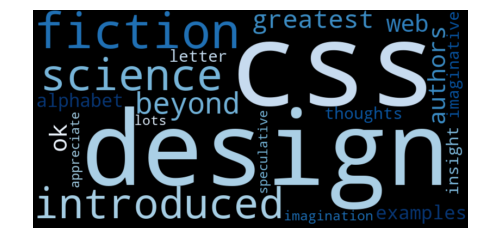

Community 1: 


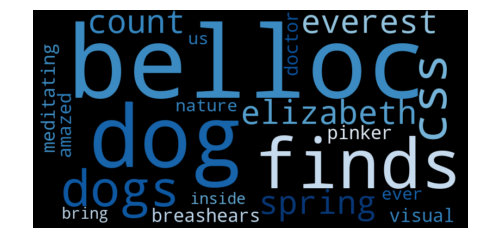

Community 2: 


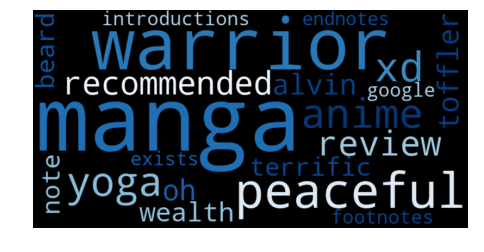

Community 3: 


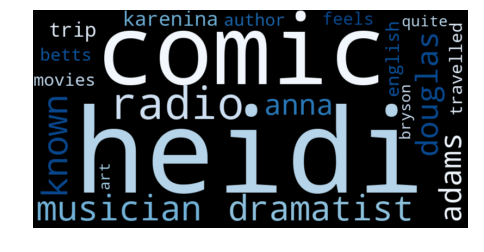

Community 4: 


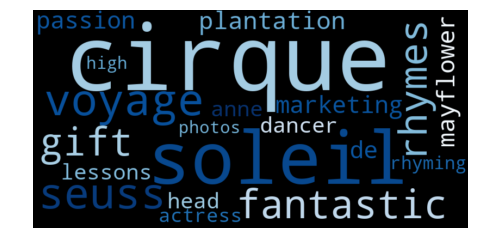

Community 5: 


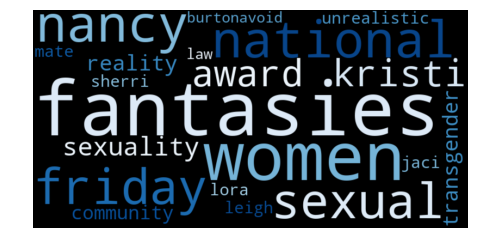

Community 6: 


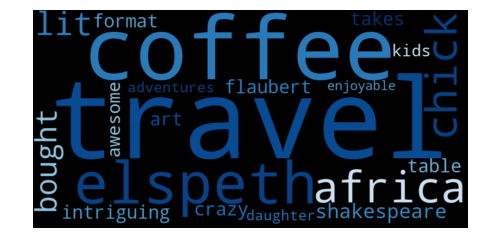

Community 7: 


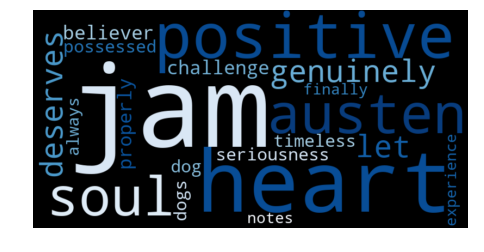

Community 8: 


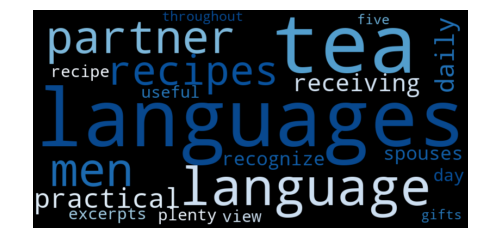

Community 9: 


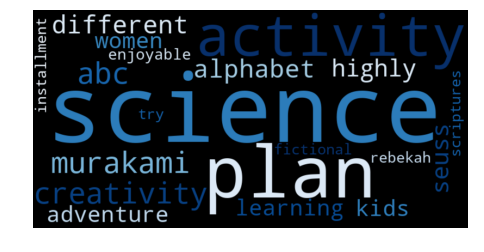

Community 10: 


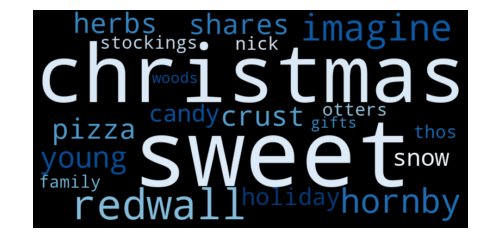

Community 11: 


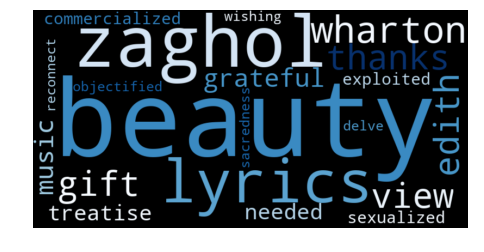

In [107]:
#print word clouds
i = 0
for community in TF_IDF_for_comunnities:
    print("Community %d: "%i)
    makeWordCloud(community)
    i+=1

<a id="HNL"></a>

## Languages
- we analysed non-english languages of reviews within Haters communities in the same way as for Fans

community0


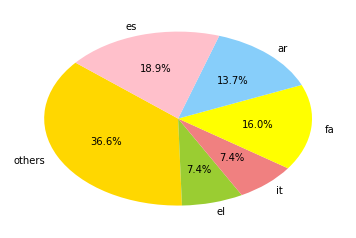

community1


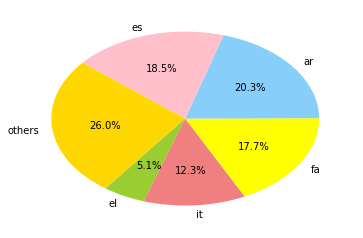

community2


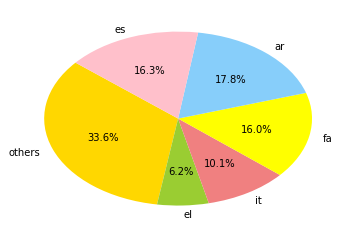

community3


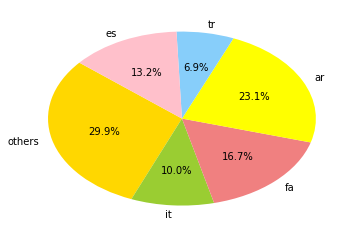

community4


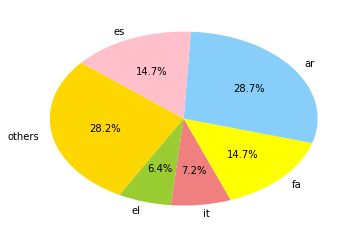

community5


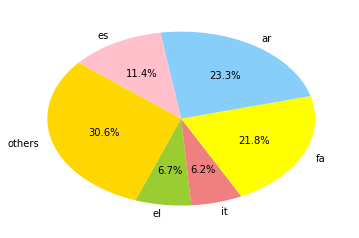

community6


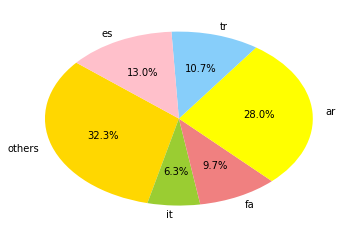

community7


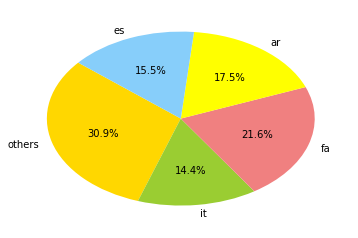

community8


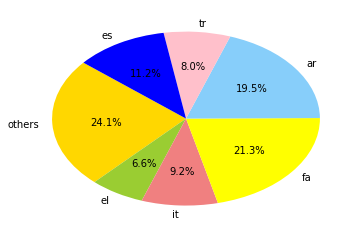

community9


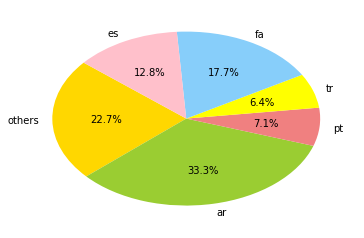

community10


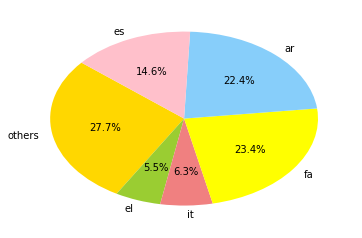

community11


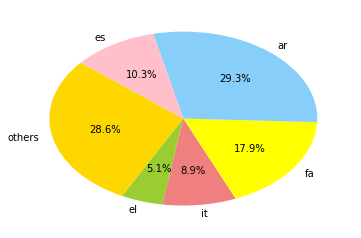

community12


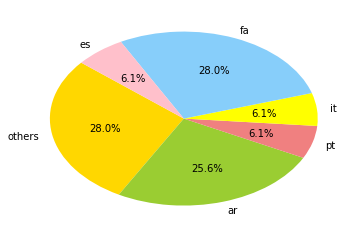

community13


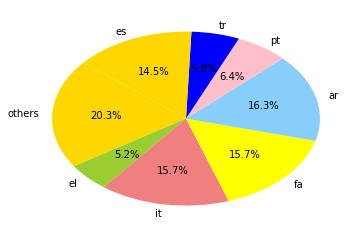

community14


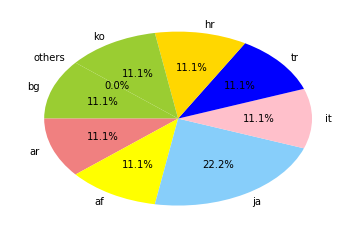

community15


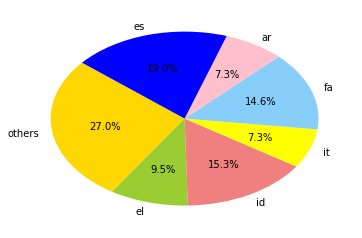

community16


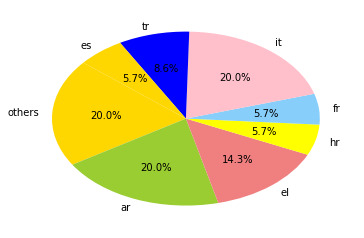

In [6]:
i = 0
for community in hater_communities:
        bookid_list = list(community.keys())
        bookid_list = [book_id[1:] for book_id in bookid_list ]
        languages = find_reviews(bookid_list[:])
        count_lan = dict()
        count_lan['others'] =0
        different_lan = set(languages)
        for di_lan in different_lan:
            temp = languages.count(di_lan)
            if float(temp)*100/float(len(languages)) < 5: 

                count_lan['others'] += temp
            else:
                count_lan[di_lan]  = temp
        labels = list(count_lan.keys())
        sizes = list(count_lan.values())
        colors = ['gold', 'yellowgreen', 'lightcoral','yellow', 'lightskyblue','pink','blue']

        plt.pie(sizes, labels=labels, shadow=False, startangle=140, colors=colors,
        autopct='%1.1f%%')
        #print(languages)
        print('community' + str(i))
        plt.show()
        i += 1

<a id="FVH"></a>

# Fans Network VS Haters Network
The **confusion matrix** is created -with haters communities on x-axis and fans communities on the y-axis -  to see which communities correspond to each other.

In [124]:
#'Haters_communities'
with open('sorted_Haters_community_weights.pkl', 'rb') as f:
    Haters_communities = pickle.load(f)

In [125]:
#fans communities
with open('sorted_community_weights', 'rb') as f:
     fan_communities = pickle.load(f)

In [126]:
#making a dict  key:community id in fan community    value: a list contains number of intersections with haters 
intersection = defaultdict(list)  
number_of_intersection = defaultdict(list) 
j = 0
for fan in fan_communities:
    fan_book_list =  list(fan.keys())
    for hater in Haters_communities:
        hater_book_list =  list(hater.keys())
        intersect = (list( set(hater_book_list)  & set(fan_book_list)))
        number_of_intersection[j].append(len(intersect))
        intersection[j].append((intersect))
    
    
    j += 1

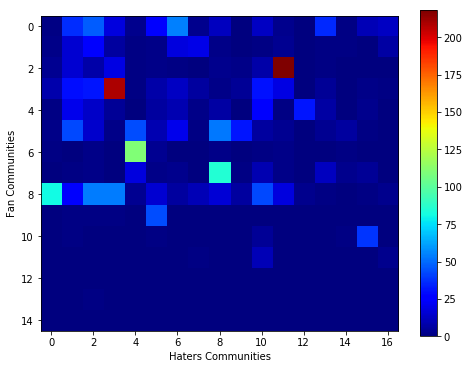

In [127]:
confusion_matrix = list()
for key,values in number_of_intersection.items():
    confusion_matrix.append(values)


plt.figure(figsize=(8,6))
plt.imshow(confusion_matrix, interpolation='nearest', cmap=plt.cm.jet)
plt.colorbar()
plt.axis('on')
plt.xlabel('Haters Communities')
plt.ylabel('Fan Communities')
plt.show()

As it is shown in the confusion matrix, community tuples (3,3) and (2,11) have a lot of books in common. To find out why people liked and disliked The very **same** books, we find the mutual books for these two tuples of communities, then we find the reviews with **positive sentiment** and **negative sentiment**, then we make word could using TF_IDF for only English reviews.

<a id="FVHP"></a>

## Positive Reviews

In [128]:
#get reviews
data = pd.read_pickle("/home/elika/uni/network/project/DFdescriptions_reviews_names")
#load sentiment data
labmt = pd.read_csv("/home/elika/uni/network/project/file.csv")

In [134]:
# a list containg the index of mutual communities in fans and haters
match_fans = [2,3]
match_haters = [11,3]

index_of_intersection = list(zip(match_fans, match_haters))
print((index_of_intersection))

[(2, 11), (3, 3)]


In [135]:
pos_reviews = list()
pos_sentiment = list()
languages = list()
for tuples in index_of_intersection:
    intersect_bookids = intersection[tuples[0]][tuples[1]]
    intersect_bookids = [bookid[1:] for bookid in intersect_bookids]
    positive_lang,positive_reviews, positive_sentiments = FIND_POSITIVE_REVIEWS(intersect_bookids)
    pos_reviews.append(positive_reviews)
    pos_sentiment.append(positive_sentiments)
    languages.append(positive_lang)

In [136]:
final_list = list()
for reviews in pos_reviews:
    templist = list()
    for items in reviews:
        for word in items:
            templist.extend(word)
    final_list.append(templist)

In [137]:
#TF_IDF
# finding frequency for each word for each community
fre_commun = list()
for item in final_list:
    fre_commun.append(nltk.FreqDist(item))

#find a set of all words
words = list()
for community in fre_commun:
    words.extend((dict(community)).keys())
words = set(words)

idf = dict()
for word in words:
    i = 0 
    for community in fre_commun:
        words_in_community = list(dict(community).keys())
        if word in set(words_in_community):
            i +=1
            
    idf[word] = (np.log(len(fre_commun)/float(i)))
    

TF_IDF_for_comunnities = list()
for comminity in fre_commun:
    TF_IDF = dict()
    for word,freq in comminity.items():
        x = float(idf[word])
        TF_IDF[word] = x*float(freq)*100
        
    TF_IDF_for_comunnities.append(TF_IDF)

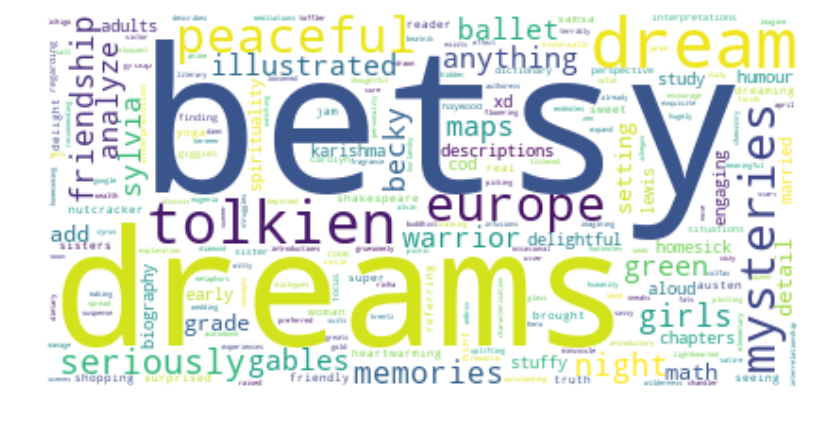

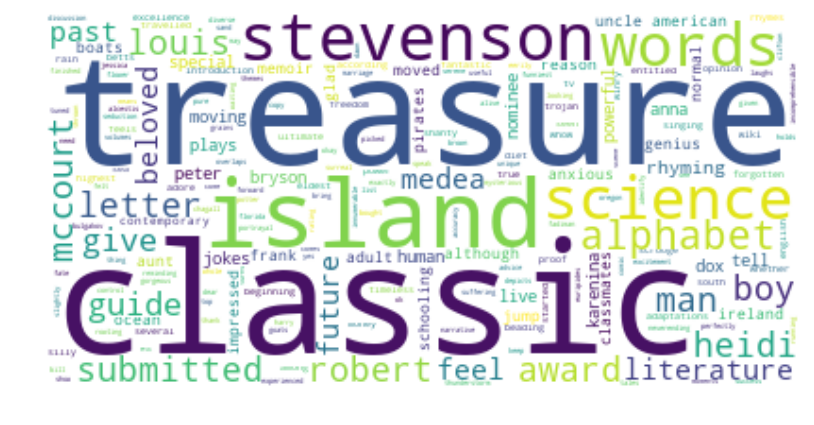

In [138]:
#word cloud
for community in TF_IDF_for_comunnities:
    community = sorted(community.items(), key=operator.itemgetter(1), reverse =True)
    community = [(key,int(math.floor(value))) for key,value in community]
    community = dict(community)
    plt.figure(figsize=(10, 5), dpi= 100)
    wordcloud = WordCloud(background_color="white").generate_from_frequencies(community)
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()
    i +=1

<a id="FVHNR"></a>

## Negative Reviews

In [140]:
neg_reviews = list()
neg_sentiment = list()
for tuples in index_of_intersection:
    intersect_bookids = intersection[tuples[0]][tuples[1]]
    intersect_bookids = [bookid[1:] for bookid in intersect_bookids]
    negative_reviews, negative_sentiments = FIND_NEGATIVE_REVIEWS(intersect_bookids)
    neg_reviews.append(negative_reviews)
    neg_sentiment.append(negative_sentiments)
    

5.867075208894536
0.37067528043318304
5.311062288244761
5.813046600688921
0.3122185873165753
5.3447187197140575


In [141]:
final_list_neg = list()
for reviews in neg_reviews:
    templist_neg = list()
    for items in reviews:
        for word in items:
            templist_neg.extend(word)
    final_list_neg.append(templist_neg)

In [142]:
# finding frequency for each word for each community
fre_commun_neg = list()
for item in final_list_neg:
    fre_commun_neg.append(nltk.FreqDist(item))

#find a set of all words
words_neg = list()
for community in fre_commun_neg:
    words_neg.extend((dict(community)).keys())
words_neg = set(words_neg)

idf_neg = dict()
for word in words_neg:
    i = 0 
    for community in fre_commun_neg:
        words_in_community = list(dict(community).keys())
        if word in set(words_in_community):
            i +=1
            
    idf_neg[word] = (np.log(len(fre_commun_neg)/float(i)))
    

TF_IDF_for_comunnities_neg = list()
for comminity in fre_commun_neg:
    TF_IDF_neg = dict()
    for word,freq in comminity.items():
        x = float(idf_neg[word])
        TF_IDF_neg[word] = x*float(freq)*100
        
    TF_IDF_for_comunnities_neg.append(TF_IDF_neg)

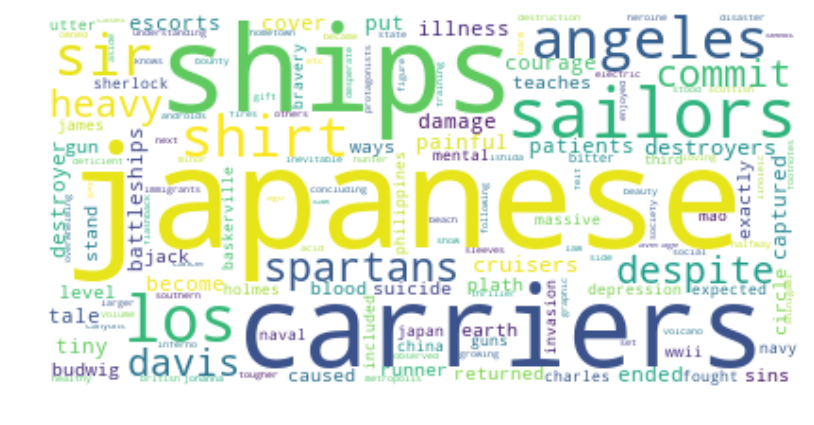

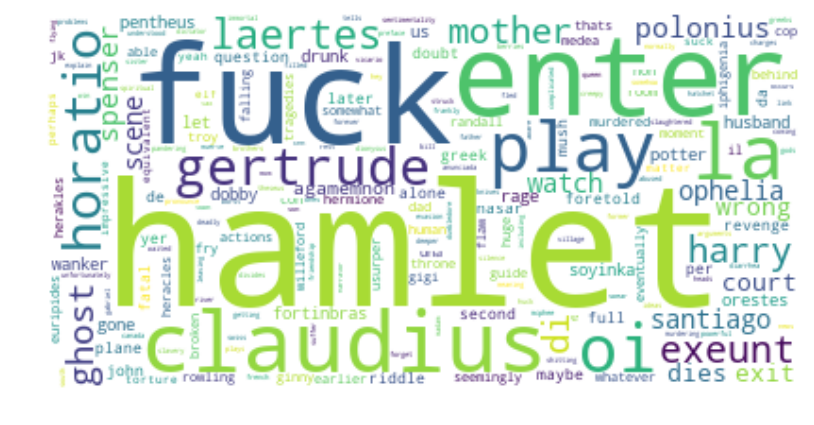

In [143]:

for community in TF_IDF_for_comunnities_neg:
    community = sorted(community.items(), key=operator.itemgetter(1), reverse =True)
    community = [(key,int(math.floor(value))) for key,value in community]
    community = dict(community)
    plt.figure(figsize=(10, 5), dpi= 100)
    wordcloud = WordCloud(background_color="white").generate_from_frequencies(community)
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()
    

<a id="FVHL"></a>

## Languages
Here you can see the frequent non-english languages for the two intersection of communities

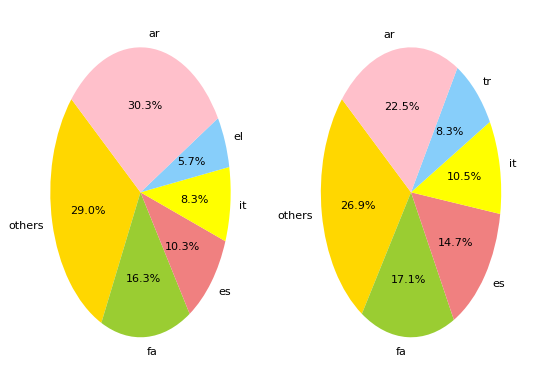

In [144]:
plot_index = [122,121]
plt.figure(figsize=(8, 6), dpi= 80)
for lan in languages:
    count_lan = dict()
    count_lan['others'] =0
    different_lan = set(lan)
    for di_lan in different_lan:
        temp = lan.count(di_lan)
        if float(temp)*100/float(len(lan)) < 5: 

            count_lan['others'] += temp
        else:
            count_lan[di_lan]  = temp
    labels = list(count_lan.keys())
    sizes = list(count_lan.values())
    colors = ['gold', 'yellowgreen', 'lightcoral','yellow', 'lightskyblue','pink','blue']
    plt.subplot(plot_index.pop())
    plt.pie(sizes, labels=labels, shadow=False, startangle=140, colors=colors,
        autopct='%1.1f%%')
  
plt.show()
    